We will implement the following structure with `PyTorch`

Step 0. Download Dataset

### Step 1. Import Libraries

In [ ]:
import numpy as np

import torchvision.transforms as transforms
from torchvision.utils import make_grid

from torch.utils.data import DataLoader
from torchvision import datasets
from torch.autograd import Variable

import torch.nn as nn
import torch.nn.functional as F
import torch
from torchvision import datasets as vdatasets

### Step 2. Initial Setting

In [ ]:
import torch
from torchvision import datasets, transforms
from torch.utils.data import DataLoader

transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
])
cifar10 = datasets.CIFAR10(root='./data', train=True, transform=transform, download=True)
cifar10_loader = DataLoader(cifar10, batch_size=32, shuffle=True)

100%|██████████| 170M/170M [00:13<00:00, 13.0MB/s]


Extracting ./data/cifar-10-python.tar.gz to ./data


In [ ]:

img_height = 256
img_width = 256
channels = 3

epoch = 0
n_epochs = 5
batch_size = 1
lr = 0.0002
b1 = 0.5
b2 = 0.999
decay_epoch = 3


### Step 3. Define Generator

In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from math import log2


factors = [1/2,1/4,1/8,1/16]

class WSConv2d(nn.Module):
    def __init__(
        self, in_channels, out_channels, kernel_size=3, stride=1, padding=1, gain=2
    ):
        super(WSConv2d, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding)
        self.scale = (gain / (in_channels * (kernel_size ** 2))) ** 0.5
        self.bias = self.conv.bias
        self.conv.bias = None

        nn.init.normal_(self.conv.weight)
        nn.init.zeros_(self.bias)

    def forward(self, x):
        return self.conv(x * self.scale) + self.bias.view(1, self.bias.shape[0], 1, 1)

class PixelNorm(nn.Module):
    def __init__(self):
        super(PixelNorm, self).__init__()
        self.epsilon = 1e-8

    def forward(self, x):
        return x / torch.sqrt(torch.mean(x ** 2, dim=1, keepdim=True) + self.epsilon)

class ConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels, use_pixelnorm=True):
        super(ConvBlock, self).__init__()
        self.use_pn = use_pixelnorm
        self.conv1 = WSConv2d(in_channels, out_channels)
        self.conv2 = WSConv2d(out_channels, out_channels)
        self.leaky = nn.LeakyReLU(0.2)
        self.pn = PixelNorm()

    def forward(self, x):
        x = self.leaky(self.conv1(x))
        x = self.pn(x) if self.use_pn else x
        x = self.leaky(self.conv2(x))
        x = self.pn(x) if self.use_pn else x
        return x

class ResidualBlock(nn.Module):
    def __init__(self, in_features):
        super(ResidualBlock, self).__init__()

        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features),
            nn.ReLU(inplace=True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features)
        )

    def forward(self, x):
        return x + self.block(x)


class Generator(nn.Module):
    def __init__(self, input_shape, num_residual_block, steps):
        super(Generator, self).__init__()
        num_residual_block = 9
        factors = [1/2**(i) for i in range(steps)]
        # starting structure of Generator should be opposite of ending structure of Discriminator
        # initial takes 1x1 -> 4x4
        # self.initial = nn.Sequential(
        #     PixelNorm(),
        #     nn.ConvTranspose2d(z_dim, in_channels, 4, 1, 0),
        #     nn.LeakyReLU(0.2),
        #     WSConv2d(in_channels, in_channels, kernel_size=3, stride=1, padding=1),
        #     nn.LeakyReLU(0.2),
        #     PixelNorm(),
        # )

        channels = input_shape[0]
        scale = 2
        downsteps = steps-1
        downscale = scale

        out_features = 64
        self.pre = []
        block = [
            nn.ReflectionPad2d(channels),
            nn.Conv2d(channels, out_features, 7),
            nn.InstanceNorm2d(out_features),
            nn.ReLU(inplace=True)
        ]
        self.pre.append(nn.Sequential(*block))

        self.pre = nn.ModuleList(self.pre)
        in_features = 64
        out_features = 64



        self.down = []
        # self.down += [
        #         nn.Conv2d(in_features, in_features, 3, stride=2, padding=1),
        #         nn.InstanceNorm2d(out_features),
        #         nn.ReLU(inplace=True)
        #     ]
        # self.down += [
        #         nn.Conv2d(in_features, in_features, 3, stride=2, padding=1),
        #         nn.InstanceNorm2d(out_features),
        #         nn.ReLU(inplace=True)
        #     ]
        for _ in range(downsteps):
            out_features *= downscale
            block = [
                nn.Conv2d(in_features, out_features, 3, stride=2, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True)
            ]
            self.down.append(nn.Sequential(*block))
            in_features = out_features

        self.down = nn.ModuleList(self.down)
        finalout = out_features

        self.mid = []
        for _ in range(num_residual_block):
            self.mid += [ResidualBlock(out_features)]

        self.mid = nn.ModuleList(self.mid)

        in_channels = out_features
        img_channels = 3
        self.initial_rgb = WSConv2d(
            in_channels, img_channels, kernel_size=1, stride=1, padding=0
        )
        self.prog_blocks, self.rgb_layers = (
            nn.ModuleList([]),
            nn.ModuleList([self.initial_rgb]),
        )

        for i in range(
            len(factors) - 1
        ):
            conv_in_c = int(in_channels * factors[i])
            conv_out_c = int(in_channels * factors[i + 1])
            self.prog_blocks.append(ConvBlock(conv_in_c, conv_out_c))
            self.rgb_layers.append(
                WSConv2d(conv_out_c, img_channels, kernel_size=1, stride=1, padding=0)
            )

    def fade_in(self, alpha, upscaled, generated):

        return torch.tanh(alpha * generated + (1 - alpha) * upscaled)

    def forward(self, x, alpha, steps):
        steps = len(self.down)-steps
        x = self.pre[0](x)
        # print(x.shape)
        mydown = []
        for layer in self.down:
          mydown.append(x)
          x = layer(x)

        for layer in self.mid:
          x = layer(x)
        out = x

        if steps == 0:
            return self.initial_rgb(out)

        for step in range(steps):
            upscaled = F.interpolate(out, scale_factor=2, mode="nearest")
            out = self.prog_blocks[step](upscaled)


        final_upscaled = self.rgb_layers[steps - 1](upscaled)
        final_out = self.rgb_layers[steps](out)
        return self.fade_in(alpha, final_upscaled, final_out)

In [ ]:
mygen = Generator((3,64,64), 0, 4)
somedata,_ = next(iter(cifar10_loader))
somedata = F.interpolate(somedata, scale_factor=1, mode='bilinear', align_corners=False)
mygen(somedata,0.5,0).shape

torch.Size([32, 3, 64, 64])

In [ ]:
from urllib.parse import uses_params
class ResidualBlock(nn.Module):
    def __init__(self, in_features):
        super(ResidualBlock, self).__init__()

        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features),
            nn.ReLU(inplace=True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features)
        )

    def forward(self, x):
        return x + self.block(x)


class GeneratorResNet(nn.Module):
    def __init__(self, input_shape, num_residual_block, steps):
        super(GeneratorResNet, self).__init__()

        channels = input_shape[0]
        scale = 2
        downsteps = steps
        downscale = scale

        out_features = 64
        self.pre = []
        block = [
            nn.ReflectionPad2d(channels),
            nn.Conv2d(channels, out_features, 7),
            nn.InstanceNorm2d(out_features),
            nn.ReLU(inplace=True)
        ]
        self.pre.append(nn.Sequential(*block))

        self.pre = nn.ModuleList(self.pre)
        in_features = 64
        out_features = 64


        # Downsampling
        self.down = []
        # self.down += [
        #         nn.Conv2d(in_features, in_features, 3, stride=2, padding=1),
        #         nn.InstanceNorm2d(out_features),
        #         nn.ReLU(inplace=True)
        #     ]
        # self.down += [
        #         nn.Conv2d(in_features, in_features, 3, stride=2, padding=1),
        #         nn.InstanceNorm2d(out_features),
        #         nn.ReLU(inplace=True)
        #     ]
        for _ in range(downsteps):
            out_features *= downscale
            block = [
                nn.Conv2d(in_features, out_features, 3, stride=2, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True)
            ]
            self.down.append(nn.Sequential(*block))
            in_features = out_features

        self.down = nn.ModuleList(self.down)
        finalout = out_features
        # Residual blocks
        self.mid = []
        for _ in range(num_residual_block):
            self.mid += [ResidualBlock(out_features)]

        self.mid = nn.ModuleList(self.mid)
        # Upsampling
        self.up = []
        for _ in range(steps):
            out_features //= scale
            block =  [
                nn.Upsample(scale_factor=2), # --> width*2, heigh*2
                nn.Conv2d(in_features, out_features, 3, stride=1, padding=1),
                nn.ReLU(inplace=True)
            ]
            self.up.append(nn.Sequential(*block))
            in_features = out_features

        self.up = nn.ModuleList(self.up)

        # self.up += [
        #         nn.Upsample(scale_factor=2), # --> width*2, heigh*2
        #         nn.Conv2d(in_features, in_features, 3, stride=1, padding=1),
        #         nn.ReLU(inplace=True)
        #     ]
        # self.up += [
        #         nn.Upsample(scale_factor=2), # --> width*2, heigh*2
        #         nn.Conv2d(in_features, in_features, 3, stride=1, padding=1),
        #         nn.ReLU(inplace=True)
        #     ]

        # Output Layer
        self.out = []
        out_features = finalout//scale
        for i in range(steps):
          # block = [nn.ReflectionPad2d(channels),
          #         nn.Conv2d(out_features, channels, 7)]
          block = [WSConv2d(
            out_features, channels, kernel_size=1, stride=1, padding=0)]
          self.out.append(nn.Sequential(*block))
          out_features = out_features// scale

        self.out = nn.ModuleList(self.out)

        self.tanh = nn.Tanh()
        # Unpacking

        # self.model = nn.Sequential(*model)

    def fade_in(self, alpha, upscaled, generated):

        return torch.tanh(alpha * generated + (1 - alpha) * upscaled)

    def forward(self, x, alpha, step):
        # print("hahaha")
        # if alpha > 0:
        originalx = x
        if step == len(self.up)-1:
          x = self.pre[0](x)

          mydown = []
          for layer in self.down:
            mydown.append(x)
            x = layer(x)



          for layer in self.mid:
            x = layer(x)

          first = self.up[-step-1](x)+mydown[step]
          first = self.out[-step-1](first)
          x = first #+ F.interpolate(originalx, scale_factor=1/2**(step), mode='bilinear', align_corners=False)
          x = self.tanh(x)
          return x


        x = self.pre[0](x)
        # print(x.shape)
        mydown = []
        for layer in self.down:
          mydown.append(x)
          x = layer(x)

        for layer in self.mid:
          x = layer(x)

        for i in range(len(self.up)-step-2):
          x = self.up[i](x) + mydown[-i-1]

        # print(x.shape)

        first = self.up[-step-1](self.up[-step-2](x)+mydown[step+1])+mydown[step]
        # print(first.shape)
        first = self.out[-step-1](first)

        second = self.up[-step-2](x)+mydown[step+1]
        # print(second.shape)
        second = self.out[-step-2](F.interpolate(second, scale_factor=2, mode='bilinear', align_corners=False))

        x = alpha * first + (1 - alpha) * second #+ F.interpolate(originalx, scale_factor=1/2**(step), mode='bilinear', align_corners=False)
        x = self.tanh(x)
        return x

In [ ]:
from urllib.parse import uses_params
class ResidualBlock(nn.Module):
    def __init__(self, in_features):
        super(ResidualBlock, self).__init__()

        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features),
            nn.ReLU(inplace=True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features)
        )

    def forward(self, x):
        return x + self.block(x)


class GeneratorResNet(nn.Module):
    def __init__(self, input_shape, num_residual_block, steps):
        super(GeneratorResNet, self).__init__()

        channels = input_shape[0]
        scale = 2
        downsteps = steps
        downscale = scale

        out_features = 64
        self.pre = []
        for i in range(downsteps):
          block = [
              nn.ReflectionPad2d(channels),
              nn.Conv2d(channels, out_features, 7),
              nn.InstanceNorm2d(out_features),
              nn.ReLU(inplace=True)
          ]
          self.pre.append(nn.Sequential(*block))
          out_features *= downscale
        self.pre = nn.ModuleList(self.pre)
        in_features = 64
        out_features = 64


        # Downsampling
        self.down = []
        # self.down += [
        #         nn.Conv2d(in_features, in_features, 3, stride=2, padding=1),
        #         nn.InstanceNorm2d(out_features),
        #         nn.ReLU(inplace=True)
        #     ]
        # self.down += [
        #         nn.Conv2d(in_features, in_features, 3, stride=2, padding=1),
        #         nn.InstanceNorm2d(out_features),
        #         nn.ReLU(inplace=True)
        #     ]
        for _ in range(downsteps):
            out_features *= downscale
            block = [
                nn.Conv2d(in_features, out_features, 3, stride=2, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True)
            ]
            self.down.append(nn.Sequential(*block))
            in_features = out_features

        self.down = nn.ModuleList(self.down)
        finalout = out_features
        # Residual blocks
        self.mid = []
        for _ in range(num_residual_block):
            self.mid += [ResidualBlock(out_features)]

        self.mid = nn.ModuleList(self.mid)
        # Upsampling
        self.up = []
        for _ in range(steps):
            out_features //= scale
            block =  [
                nn.Upsample(scale_factor=2), # --> width*2, heigh*2
                nn.Conv2d(in_features, out_features, 3, stride=1, padding=1),
                nn.ReLU(inplace=True)
            ]
            self.up.append(nn.Sequential(*block))
            in_features = out_features

        self.up = nn.ModuleList(self.up)

        # self.up += [
        #         nn.Upsample(scale_factor=2), # --> width*2, heigh*2
        #         nn.Conv2d(in_features, in_features, 3, stride=1, padding=1),
        #         nn.ReLU(inplace=True)
        #     ]
        # self.up += [
        #         nn.Upsample(scale_factor=2), # --> width*2, heigh*2
        #         nn.Conv2d(in_features, in_features, 3, stride=1, padding=1),
        #         nn.ReLU(inplace=True)
        #     ]

        # Output Layer
        self.out = []
        out_features = finalout//scale
        for i in range(steps):
          block = [nn.ReflectionPad2d(channels),
                  nn.Conv2d(out_features, channels, 7)]
          self.out.append(nn.Sequential(*block))
          out_features = out_features// scale

        self.out = nn.ModuleList(self.out)

        self.tanh = nn.Tanh()
        # Unpacking

        # self.model = nn.Sequential(*model)

    def fade_in(self, alpha, upscaled, generated):

        return torch.tanh(alpha * generated + (1 - alpha) * upscaled)

    def forward(self, x, alpha, step):
        # if alpha > 0:
        if step == len(self.pre)-1:
          first = self.pre[step](x)
          first = self.down[step](first)
          x = first
          for layer in self.mid:
            x = layer(x)

          first = self.up[-step-1](x)
          first = self.out[-step-1](first)
          x = first
          x = self.tanh(x)
          return x

        first = self.pre[step](x)
        first = self.down[step](first)
        first = self.down[step+1](first)
        second = self.pre[step+1](x)
        second = self.down[step+1](F.interpolate(second, scale_factor=0.5, mode='bilinear', align_corners=False))
        x = alpha * first + (1 - alpha) * second

        for layer in self.down[step+2:]:
          x = layer(x)
        for layer in self.mid:
          x = layer(x)

        for layer in self.up[:-step-2]:
          x = layer(x)

        first = self.up[-step-1](self.up[-step-2](x))
        # print(first.shape)
        first = self.out[-step-1](first)

        second = self.up[-step-2](x)
        # print(second.shape)
        second = self.out[-step-2](F.interpolate(second, scale_factor=2, mode='bilinear', align_corners=False))

        x = alpha * first + (1 - alpha) * second
        x = self.tanh(x)
        return x

In [ ]:
class GeneratorResNet(nn.Module):
    def __init__(self, input_shape, num_residual_block, steps):
        super(GeneratorResNet, self).__init__()

        channels = input_shape[0]


        out_features = 64
        model = [
            nn.ReflectionPad2d(channels),
            nn.Conv2d(channels, out_features, 7),
            nn.InstanceNorm2d(out_features),
            nn.ReLU(inplace=True)
        ]
        in_features = out_features

        for _ in range(2):
            out_features *= 2
            model += [
                nn.Conv2d(in_features, out_features, 3, stride=2, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True)
            ]
            in_features = out_features


        for _ in range(num_residual_block):
            model += [ResidualBlock(out_features)]

        # Upsampling
        for _ in range(2):
            out_features //= 2
            model += [
                nn.Upsample(scale_factor=2),
                nn.Conv2d(in_features, out_features, 3, stride=1, padding=1),
                nn.ReLU(inplace=True)
            ]
            in_features = out_features

        # Output Layer
        model += [nn.ReflectionPad2d(channels),
                  nn.Conv2d(out_features, channels, 7),
                  nn.Tanh()
                 ]

        # Unpacking
        self.model = nn.Sequential(*model)

    def forward(self, x, alpha, step):
        return self.model(x)

In [ ]:
mygen = GeneratorResNet((3,64,64), 0, 4)
somedata,_ = next(iter(cifar10_loader))
somedata = F.interpolate(somedata, scale_factor=1, mode='bilinear', align_corners=False)
mygen(somedata,0.5,0).shape

torch.Size([32, 3, 64, 64])

> TEST CODE : nn.Upsample

### Step 4. Define Discriminator

In [ ]:
class Discriminator(nn.Module):
    def __init__(self, input_shape, steps):
        super(Discriminator, self).__init__()

        channels, height, width = input_shape

        self.output_shape = (1, height//2**4, width//2**4)

        def discriminator_block(in_filters, out_filters, normalize=True):
            """Returns downsampling layers of each discriminator block"""
            layers = [nn.Conv2d(in_filters, out_filters, 4, stride=2, padding=1)]
            if normalize:
                layers.append(nn.InstanceNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *discriminator_block(channels, 64, normalize=False),
            *discriminator_block(64, 128),
            *discriminator_block(128,256),
            *discriminator_block(256,512),
            nn.ZeroPad2d((1,0,1,0)),
            nn.Conv2d(512, 1, 4, padding=1)
        )
    def forward(self, img, alpha, step):
        return self.model(img)


In [ ]:
class Discriminator(nn.Module):
    def __init__(self, input_shape, steps):
        super(Discriminator, self).__init__()

        channels, height, width = input_shape


        self.output_shape = (1, height//2**4, width//2**4)

        def discriminator_block(in_filters, out_filters, normalize=True):
            """Returns downsampling layers of each discriminator block"""
            layers = [nn.Conv2d(in_filters, out_filters, 4, stride=2, padding=1)]
            if normalize:
                layers.append(nn.InstanceNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return nn.Sequential(*layers)

        def pre_block(in_filters, out_filters, normalize=True):
            """Returns downsampling layers of each discriminator block"""
            layers = [nn.Conv2d(in_filters, out_filters, 3, stride=1, padding=1)]
            if normalize:
                layers.append(nn.InstanceNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return nn.Sequential(*layers)

        inc = 64
        outc = 128
        self.pre = []
        for i in range(steps):
          self.pre.append(pre_block(channels, inc, normalize=False))
          inc = outc
          outc = outc*2

        self.pre = nn.ModuleList(self.pre)

        inc = 64
        outc = 128
        self.model = []
        for i in range(steps):
          self.model.append(discriminator_block(inc, outc))
          inc = outc
          outc = outc*2

        self.model = nn.ModuleList(self.model)
        # nn.ZeroPad2d((1,0,1,0)),
        self.out = nn.ModuleList([ nn.Conv2d(inc, 1, 1)])


    def forward(self, img, alpha, step):
        if step == len(self.pre)-1:
          x = self.pre[step](img)
          x = self.model[step](x)
          for layer in self.out:
            x = layer(x)
          return x.squeeze(1)


        first = self.pre[step](img)
        first = self.model[step+1](self.model[step](first))
        second = self.pre[step+1](F.interpolate(img, scale_factor=0.5, mode='bilinear', align_corners=False))
        second = self.model[step+1](second)
        x = alpha * first + (1 - alpha) * second

        for layer in self.model[step+2:]:
          x = layer(x)
        # print(x.shape)
        for layer in self.out:
          x = layer(x)
        return x #.squeeze(1)

In [ ]:
mydis = Discriminator((3,64,64), 4)
somedata,_ = next(iter(cifar10_loader))
somedata = F.interpolate(somedata, scale_factor=1, mode='bilinear', align_corners=False)
mydis(somedata,1,0).shape

torch.Size([32, 1, 4, 4])

> TEST CODE : nn.ZeroPad2d

In [ ]:
from torchvision.datasets import CelebA
from torchvision.transforms import Compose, Resize, CenterCrop, ToTensor, Normalize
from torch.utils.data import DataLoader
import torch
from torchvision import datasets, transforms
from torch.utils.data import DataLoader
import torchvision
import torchvision.transforms as transforms
import torch
import os
import shutil
from sklearn.model_selection import train_test_split
from torchvision.datasets import ImageFolder
from torchvision.transforms import Compose, Resize, CenterCrop, ToTensor, Normalize
from torch.utils.data import DataLoader

from torch.utils.data import Dataset
from glob import glob
import matplotlib.pyplot as plt
import torchvision.transforms as T
import torchvision.transforms.functional as transF
import pickle
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

In [ ]:
!unzip ./van_goah_jpg.zip -d ./dataset_root/van_goah_jpg

Archive:  ./van_goah_jpg.zip
   creating: ./dataset_root/van_goah_jpg/van_goah_jpg/
  inflating: ./dataset_root/van_goah_jpg/__MACOSX/._van_goah_jpg  
  inflating: ./dataset_root/van_goah_jpg/van_goah_jpg/.DS_Store  
  inflating: ./dataset_root/van_goah_jpg/__MACOSX/van_goah_jpg/._.DS_Store  
   creating: ./dataset_root/van_goah_jpg/van_goah_jpg/test/
  inflating: ./dataset_root/van_goah_jpg/__MACOSX/van_goah_jpg/._test  
   creating: ./dataset_root/van_goah_jpg/van_goah_jpg/train/
  inflating: ./dataset_root/van_goah_jpg/__MACOSX/van_goah_jpg/._train  
  inflating: ./dataset_root/van_goah_jpg/van_goah_jpg/test/1019.jpg  
  inflating: ./dataset_root/van_goah_jpg/__MACOSX/van_goah_jpg/test/._1019.jpg  
  inflating: ./dataset_root/van_goah_jpg/van_goah_jpg/test/1025.jpg  
  inflating: ./dataset_root/van_goah_jpg/__MACOSX/van_goah_jpg/test/._1025.jpg  
  inflating: ./dataset_root/van_goah_jpg/van_goah_jpg/test/1031.jpg  
  inflating: ./dataset_root/van_goah_jpg/__MACOSX/van_goah_jpg/test/

In [ ]:
!mkdir -p ./dataset_root/monet_jpg
!curl -L -o ./dataset_root/monet_jpg/monet2photo.zip \
  https://www.kaggle.com/api/v1/datasets/download/balraj98/monet2photo
!unzip ./dataset_root/monet_jpg/monet2photo.zip -d ./dataset_root/monet_jpg
!rm ./dataset_root/monet_jpg/monet2photo.zip

Streaming output truncated to the last 5000 lines.
  inflating: ./dataset_root/monet_jpg/trainB/2015-02-12 11_31_32.jpg  
  inflating: ./dataset_root/monet_jpg/trainB/2015-02-12 12_30_32.jpg  
  inflating: ./dataset_root/monet_jpg/trainB/2015-02-12 19_51_27.jpg  
  inflating: ./dataset_root/monet_jpg/trainB/2015-02-12 20_53_44.jpg  
  inflating: ./dataset_root/monet_jpg/trainB/2015-02-12 21_31_48.jpg  
  inflating: ./dataset_root/monet_jpg/trainB/2015-02-13 09_22_26.jpg  
  inflating: ./dataset_root/monet_jpg/trainB/2015-02-13 10_07_16.jpg  
  inflating: ./dataset_root/monet_jpg/trainB/2015-02-13 13_57_11.jpg  
  inflating: ./dataset_root/monet_jpg/trainB/2015-02-13 16_02_50.jpg  
  inflating: ./dataset_root/monet_jpg/trainB/2015-02-13 16_45_49.jpg  
  inflating: ./dataset_root/monet_jpg/trainB/2015-02-14 00_09_27.jpg  
  inflating: ./dataset_root/monet_jpg/trainB/2015-02-14 02_21_28.jpg  
  inflating: ./dataset_root/monet_jpg/trainB/2015-02-14 02_26_30.jpg  
  inflating: ./dataset_roo

In [ ]:

base_path = "./dataset_root/monet_jpg"

paths_to_delete = ["trainB", "testB", "metadata.csv"]


for item in paths_to_delete:
    item_path = os.path.join(base_path, item)
    if os.path.isdir(item_path):
        shutil.rmtree(item_path)
        print(f"Deleted directory: {item_path}")
    elif os.path.isfile(item_path):
        os.remove(item_path)
        print(f"Deleted file: {item_path}")

rename_map = {"trainA": "train", "testA": "test"}

for old_name, new_name in rename_map.items():
    old_path = os.path.join(base_path, old_name)
    new_path = os.path.join(base_path, new_name)
    if os.path.exists(old_path):
        os.rename(old_path, new_path)
        print(f"Renamed {old_name} to {new_name}")

Deleted directory: ./dataset_root/monet_jpg/trainB
Deleted directory: ./dataset_root/monet_jpg/testB
Deleted file: ./dataset_root/monet_jpg/metadata.csv
Renamed trainA to train
Renamed testA to test


In [ ]:
transform = transforms.Compose(
    [transforms.ToTensor(),
    #  transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
     ]
    )

batch_size = 4

CIFAR10_trainset = torchvision.datasets.CIFAR10(root='./data/CIFAR10', train=True,
                                        download=True, transform=transform)
CIFAR10_trainloader = torch.utils.data.DataLoader(CIFAR10_trainset, batch_size=batch_size,
                                          shuffle=True, num_workers=2)

CIFAR10_testset = torchvision.datasets.CIFAR10(root='./data/CIFAR10', train=False,
                                       download=True, transform=transform)
CIFAR10_testloader = torch.utils.data.DataLoader(CIFAR10_testset, batch_size=batch_size,
                                         shuffle=False, num_workers=2)

100%|██████████| 170M/170M [00:13<00:00, 13.0MB/s]


Extracting ./data/CIFAR10/cifar-10-python.tar.gz to ./data/CIFAR10
Files already downloaded and verified


In [ ]:

def unpickle(file):
    with open(file, 'rb') as fo:
        dict = pickle.load(fo, encoding='bytes')
    return dict

def save_cifar10_as_jpg(input_dir, output_dir):
    if not os.path.exists(output_dir):
        os.makedirs(output_dir)

    for batch in range(1, 6):
        batch_file = os.path.join(input_dir, f"data_batch_{batch}")
        batch_data = unpickle(batch_file)
        images = batch_data[b'data']
        labels = batch_data[b'labels']

        for i, img_data in enumerate(images):
            img = np.reshape(img_data, (3, 32, 32)).transpose(1, 2, 0)
            img = Image.fromarray(img)
            img.save(os.path.join(output_dir, f"train_{batch}_{i}.jpg"))

    test_file = os.path.join(input_dir, "test_batch")
    test_data = unpickle(test_file)
    images = test_data[b'data']
    for i, img_data in enumerate(images):
        img = np.reshape(img_data, (3, 32, 32)).transpose(1, 2, 0)
        img = Image.fromarray(img)
        img.save(os.path.join(output_dir, f"test_{i}.jpg"))

cifar10_input_dir = "./data/CIFAR10/cifar-10-batches-py"
cifar10_output_dir = "./dataset_root/cifar10_jpg"
save_cifar10_as_jpg(cifar10_input_dir, cifar10_output_dir)

In [ ]:
def to_rgb(image):
    rgb_image = Image.new("RGB", image.size)
    rgb_image.paste(image)
    return rgb_image

class ImageDataset_general(Dataset):
    def __init__(self, root, transforms_=None, unaligned=False, mode='train', dataset_A='van_goah_jpg', dataset_B='cifar10_jpg'):
        """
        :param root: Root directory path
        :param transforms_: Data preprocessing transformations
        :param unaligned: Whether to use unaligned data
        :param mode: Mode, either 'train' or 'test'
        :param dataset_A: Name of the first dataset ('van_goah_jpg', 'monet_jpg')
        :param dataset_B: Name of the second dataset ('cifar10_jpg', 'celeba_jpg', 'lsun_jpg')
        """
        self.transform = transforms.Compose(transforms_)
        self.unaligned = unaligned
        self.mode = mode
        self.dataset_A = dataset_A
        self.dataset_B = dataset_B

        if self.mode == 'train':
#             self.files_A = sorted(glob.glob(os.path.join(root, self.dataset_A, '**', '*.*'), recursive=True))[:250]
#             self.files_B = sorted(glob.glob(os.path.join(root, self.dataset_B, '**', '*.*'), recursive=True))[:250]
            self.files_A = sorted(glob(os.path.join(root, self.dataset_A, '**', '*.*'), recursive=True))[:250]
            self.files_B = sorted(glob(os.path.join(root, self.dataset_B, '**', '*.*'), recursive=True))[:250]
        elif self.mode == 'test':
#             self.files_A = sorted(glob.glob(os.path.join(root, self.dataset_A, '**', '*.*'), recursive=True))[250:301]
#             self.files_B = sorted(glob.glob(os.path.join(root, self.dataset_B, '**', '*.*'), recursive=True))[250:301]
            self.files_A = sorted(glob(os.path.join(root, self.dataset_A, '**', '*.*'), recursive=True))[250:301]
            self.files_B = sorted(glob(os.path.join(root, self.dataset_B, '**', '*.*'), recursive=True))[250:301]

    def __getitem__(self, index):

        image_A = Image.open(self.files_A[index % len(self.files_A)])


        if self.unaligned:
            image_B = Image.open(self.files_B[np.random.randint(0, len(self.files_B) - 1)])
        else:
            image_B = Image.open(self.files_B[index % len(self.files_B)])


        if image_A.mode != 'RGB':
            image_A = to_rgb(image_A)
            # image_A = image_A.convert('RGB')
        if image_B.mode != 'RGB':
            image_B = to_rgb(image_B)
            # image_B = image_B.convert('RGB')


        item_A = self.transform(image_A)
        item_B = self.transform(image_B)
        return {'A': item_A, 'B': item_B}

    def __len__(self):

        return max(len(self.files_A), len(self.files_B))

In [ ]:
# transforms_ = [
#     transforms.Resize((64, 64)),
#     transforms.ToTensor(),
# #     transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
# ]
batch_size = 2
transforms_ = [
    transforms.Resize((64, 64)),
    # transforms.Resize(int(img_height*1.12), Image.BICUBIC),
    # transforms.RandomCrop((64, 64)),
    # transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
]

style = "van_goah_jpg"
real = 'cifar10_jpg'


mon_Cifar_train_dataset = ImageDataset_general(
    root="./dataset_root",
    transforms_=transforms_,
    unaligned=True,
    mode='train',
    dataset_A=style,
    dataset_B=real
)
mon_Cifar_test_dataset = ImageDataset_general(
    root="./dataset_root",
    transforms_=transforms_,
    unaligned=True,
    mode='test',
    dataset_A=style,
    dataset_B=real
)
mon_Cifar_train_dataloader = DataLoader(
    ImageDataset_general(
        root="./dataset_root",
        transforms_=transforms_,
        unaligned=True,
        mode='train',
        dataset_A=style,
        dataset_B=real
    ),
    batch_size=batch_size,
    shuffle=True,
    num_workers=0
)
mon_Cifar_test_dataloader = DataLoader(
        ImageDataset_general(
        root="./dataset_root",
        transforms_=transforms_,
        unaligned=True,
        mode='test',
        dataset_A=style,
        dataset_B=real
    ),
    batch_size=batch_size,
    shuffle=True,
    num_workers=0
)

Dataset A (van_goah_jpg) has 250 images.
Dataset B (cifar10_jpg) has 250 images.
Dataset A (van_goah_jpg) has 51 images.
Dataset B (cifar10_jpg) has 51 images.


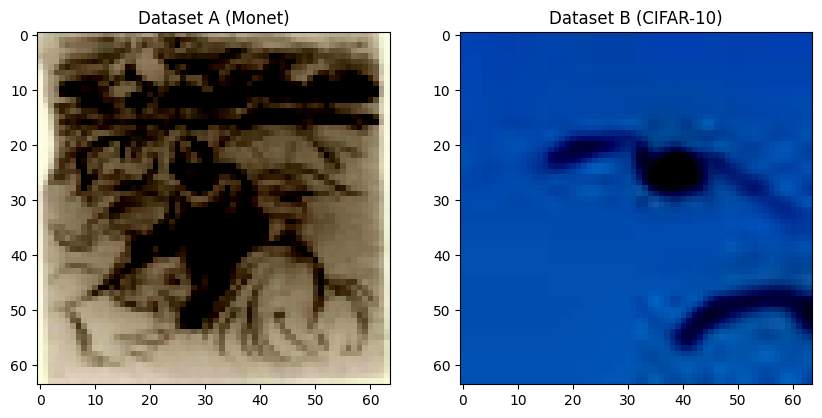

In [ ]:
import torchvision.transforms.functional as transF
print(f"Dataset A ({mon_Cifar_train_dataset.dataset_A}) has {len(mon_Cifar_train_dataset.files_A)} images.")
print(f"Dataset B ({mon_Cifar_train_dataset.dataset_B}) has {len(mon_Cifar_train_dataset.files_B)} images.")
print(f"Dataset A ({mon_Cifar_test_dataset.dataset_A}) has {len(mon_Cifar_test_dataset.files_A)} images.")
print(f"Dataset B ({mon_Cifar_test_dataset.dataset_B}) has {len(mon_Cifar_test_dataset.files_B)} images.")

inv_transform = T.ToPILImage()

for batch in mon_Cifar_train_dataloader:
    images_A = batch['A']
    images_B = batch['B']

    image_A_show = images_A[0].cpu().permute(1,2,0)
    image_B_show = images_B[0].cpu().permute(1,2,0)

    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.title("Dataset A (Monet)")
    plt.imshow(image_A_show)

    plt.subplot(1, 2, 2)
    plt.title("Dataset B (CIFAR-10)")
    plt.imshow(image_B_show, cmap='viridis', vmin=-1, vmax=1)

    plt.show()
    break

### Step 13. Define function to get sample images

In [ ]:
import matplotlib.pyplot as plt
cuda = torch.cuda.is_available()

In [ ]:
Tensor = torch.cuda.FloatTensor if cuda else torch.Tensor

In [ ]:
def sample_images(val_dataloader, step):
    """show a generated sample from the test set"""
    imgs = next(iter(val_dataloader))
    G_AB.eval()
    G_BA.eval()
    real_A = imgs['A'].type(Tensor)

    fake_B = G_AB(real_A, 1, step).detach()
    real_B = imgs['B'].type(Tensor)

    fake_A = G_BA(real_B, 1, step).detach()

    real_A = F.interpolate(real_A, scale_factor=1/2**(step), mode='bilinear', align_corners=False)
    real_B = F.interpolate(real_B, scale_factor=1/2**(step), mode='bilinear', align_corners=False)

    real_A = make_grid(real_A, nrow=5, normalize=True)
    fake_B = make_grid(fake_B, nrow=5, normalize=True)
    real_B = make_grid(real_B, nrow=5, normalize=True)
    fake_A = make_grid(fake_A, nrow=5, normalize=True)

    image_grid = torch.cat((real_A, fake_B, real_B, fake_A), 1)
    plt.imshow(image_grid.cpu().permute(1,2,0))
    plt.title('Real A vs Fake B | Real B vs Fake A')
    plt.axis('off')
    plt.show();

### Step 14. Training

In [ ]:
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import warnings

In [ ]:
def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
        if hasattr(m, 'bias') and m.bias is not None:
            torch.nn.init.constant_(m.bias.data, 0.0)
        elif classname.find('BatchNorm2d') != -1:
            torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
            torch.nn.init.constant_(m.bias.data, 0.0)

criterion_GAN = torch.nn.MSELoss() #torch.nn.BCEWithLogitsLoss()
criterion_cycle = torch.nn.L1Loss()
criterion_identity = torch.nn.L1Loss() #torch.nn.MSELoss()
input_shape =  (3,64,64) #(c,h, w)
n_residual_blocks = 9
steps = 4

G_AB = Generator(input_shape, n_residual_blocks, steps)
G_BA = Generator(input_shape, n_residual_blocks, steps)
D_A = Discriminator(input_shape, steps)
D_B = Discriminator(input_shape, steps)
# G_AB = GeneratorResNet(input_shape, n_residual_blocks, steps)
# G_BA = GeneratorResNet(input_shape, n_residual_blocks, steps)
# D_A = Discriminator(input_shape, steps)
# D_B = Discriminator(input_shape, steps)

cuda = torch.cuda.is_available()

if cuda:
    G_AB = G_AB.cuda()
    G_BA = G_BA.cuda()
    D_A = D_A.cuda()
    D_B = D_B.cuda()

    criterion_GAN.cuda()
    criterion_cycle.cuda()
    criterion_identity.cuda()

# G_AB.apply(weights_init_normal)
# G_BA.apply(weights_init_normal)
# D_A.apply(weights_init_normal)
# D_B.apply(weights_init_normal)

import itertools
lr = 0.0002
b1 = 0.5
b2 = 0.999

optimizer_G = torch.optim.Adam(
    itertools.chain(G_AB.parameters(), G_BA.parameters()), lr=lr, betas=(b1,b2)
)

optimizer_D_A = torch.optim.Adam(
    D_A.parameters(), lr=lr, betas=(b1,b2)
)
optimizer_D_B = torch.optim.Adam(
    D_B.parameters(), lr=lr, betas=(b1,b2)
)

class LambdaLR:
    def __init__(self, n_epochs, offset, decay_start_epoch):
        assert (n_epochs - decay_start_epoch) > 0, "Decay must start before the training session ends!"
        self.n_epochs = n_epochs
        self.offset = offset
        self.decay_start_epoch = decay_start_epoch

    def step(self, epoch):
        return 1.0 - max(0, epoch+self.offset - self.decay_start_epoch)/(self.n_epochs - self.decay_start_epoch)


n_epochs = 10
epoch = 0
decay_epoch = 5


lr_scheduler_G = torch.optim.lr_scheduler.LambdaLR(
    optimizer_G,
    lr_lambda=LambdaLR(n_epochs, epoch, decay_epoch).step
)

lr_scheduler_D_A = torch.optim.lr_scheduler.LambdaLR(
    optimizer_D_A,
    lr_lambda=LambdaLR(n_epochs, epoch, decay_epoch).step
)
lr_scheduler_D_B = torch.optim.lr_scheduler.LambdaLR(
    optimizer_D_B,
    lr_lambda=LambdaLR(n_epochs, epoch, decay_epoch).step
)

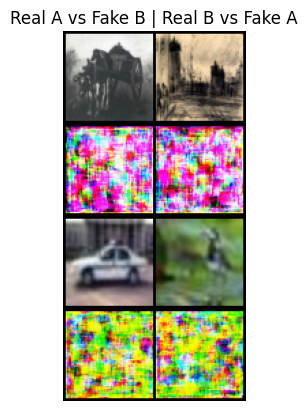

In [ ]:
sample_images(mon_Cifar_train_dataloader, 0)

  0%|          | 0/125 [00:00<?, ?it/s]

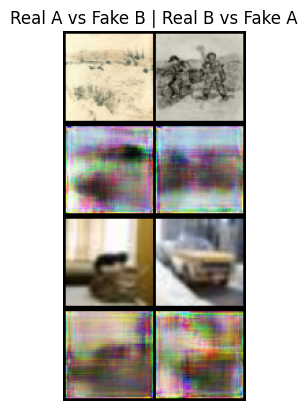

[Epoch 1/10] [Batch 125/125] [D loss : 0.271330] [G loss : 5.957810 - (adv : 0.299265, cycle : 0.384831, identity : 0.362047)]


  0%|          | 0/125 [00:00<?, ?it/s]

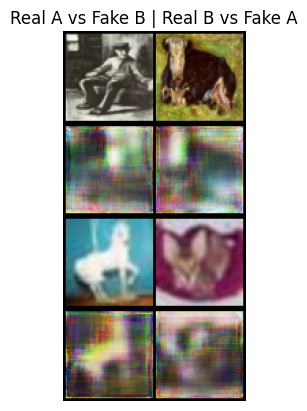

[Epoch 2/10] [Batch 125/125] [D loss : 0.247449] [G loss : 4.702334 - (adv : 0.308001, cycle : 0.296115, identity : 0.286637)]


  0%|          | 0/125 [00:00<?, ?it/s]

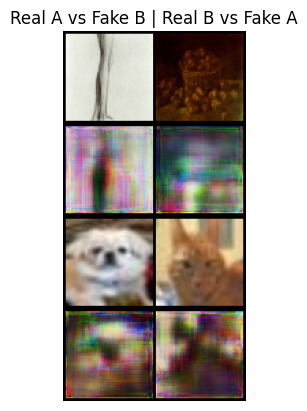

[Epoch 3/10] [Batch 125/125] [D loss : 0.227982] [G loss : 4.607398 - (adv : 0.333402, cycle : 0.285959, identity : 0.282881)]


  0%|          | 0/125 [00:00<?, ?it/s]

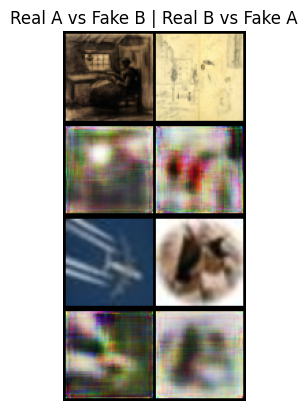

[Epoch 4/10] [Batch 125/125] [D loss : 0.167806] [G loss : 4.748689 - (adv : 0.407345, cycle : 0.301866, identity : 0.264536)]


  0%|          | 0/125 [00:00<?, ?it/s]

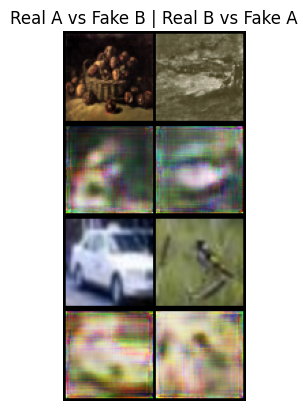

[Epoch 5/10] [Batch 125/125] [D loss : 0.164553] [G loss : 3.494778 - (adv : 0.471373, cycle : 0.207459, identity : 0.189762)]


  0%|          | 0/125 [00:00<?, ?it/s]

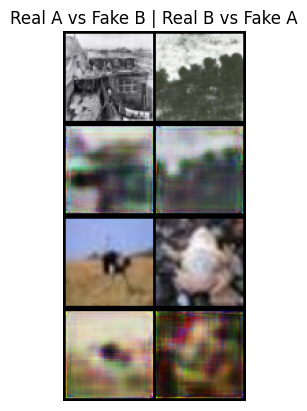

[Epoch 6/10] [Batch 125/125] [D loss : 0.153129] [G loss : 3.682340 - (adv : 0.432072, cycle : 0.224591, identity : 0.200871)]


  0%|          | 0/125 [00:00<?, ?it/s]

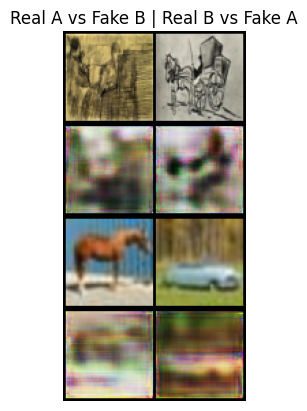

[Epoch 7/10] [Batch 125/125] [D loss : 0.141284] [G loss : 4.227677 - (adv : 0.527491, cycle : 0.252259, identity : 0.235520)]


  0%|          | 0/125 [00:00<?, ?it/s]

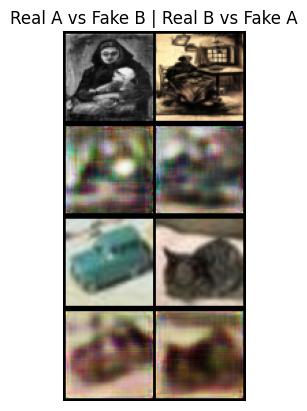

[Epoch 8/10] [Batch 125/125] [D loss : 0.177871] [G loss : 4.279136 - (adv : 0.527758, cycle : 0.257306, identity : 0.235665)]


  0%|          | 0/125 [00:00<?, ?it/s]

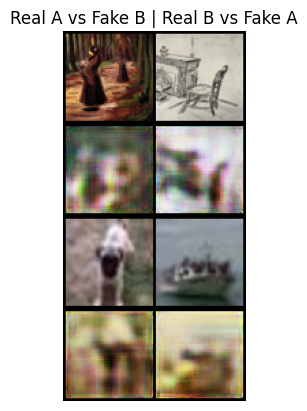

[Epoch 9/10] [Batch 125/125] [D loss : 0.053202] [G loss : 4.163401 - (adv : 0.736232, cycle : 0.213226, identity : 0.258983)]


  0%|          | 0/125 [00:00<?, ?it/s]

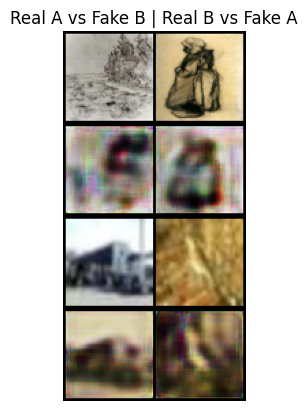

[Epoch 10/10] [Batch 125/125] [D loss : 0.103638] [G loss : 3.759315 - (adv : 0.652462, cycle : 0.214738, identity : 0.191896)]


In [ ]:
# none progressive encoder
traindataloader = mon_Cifar_train_dataloader
n_epochs = 10
# for step in [3,2,1,0]:
for step in [0]:
  if step == 0:
    n_epochs = 10

  for epoch in range(n_epochs):
      alpha = 1 #min(2*epoch/n_epochs, 1) #
      for i, batch in enumerate(tqdm(traindataloader)):

          # if epoch == 0:
          #   alpha = i/(len(traindataloader))


          real_A = batch['A'].type(Tensor)



          real_B = batch['B'].type(Tensor)
          check_A = F.interpolate(real_A, scale_factor=1/2**(step), mode='bilinear', align_corners=False)
          check_B = F.interpolate(real_B, scale_factor=1/2**(step), mode='bilinear', align_corners=False)

          valid = Tensor(np.ones((real_A.size(0), 1, 4, 4)))
          fake = Tensor(np.zeros((real_A.size(0), 1, 4, 4)))



          G_AB.train()
          G_BA.train()

          optimizer_G.zero_grad()



          loss_id_A = criterion_identity(G_BA(real_A, alpha, step), check_A)
          loss_id_B = criterion_identity(G_AB(real_B, alpha, step), check_B)
          loss_identity = (loss_id_A + loss_id_B)/2

          # GAN Loss

          fake_B = G_AB(real_A, alpha, step)
          # print(fake_B.shape)
          # print(fake_B.shape, D_B(fake_B, 1, step).shape)
          loss_GAN_AB = criterion_GAN(D_B(fake_B, alpha, step), valid)

          fake_A = G_BA(real_B, 1, step)
          loss_GAN_BA = criterion_GAN(D_A(fake_A, alpha, step), valid)

          loss_GAN = (loss_GAN_AB + loss_GAN_BA)/2

          # Cycle Loss
          #resize
          upfake_B = F.interpolate(fake_B, scale_factor=2**(step), mode='bilinear', align_corners=False)
          upfake_A = F.interpolate(fake_A, scale_factor=2**(step), mode='bilinear', align_corners=False)


          recov_A = G_BA(upfake_B,alpha,step)
          loss_cycle_A = criterion_cycle(recov_A, check_A)
          recov_B = G_AB(upfake_A,alpha,step)
          loss_cycle_B = criterion_cycle(recov_B, check_B)

          loss_cycle = (loss_cycle_A + loss_cycle_B)/2


          loss_G = loss_GAN + (10.0*loss_cycle) + (5.0*loss_identity)

          loss_G.backward()
          optimizer_G.step()


          optimizer_D_A.zero_grad()
          # print("haha", D_B(fake_B, 1, step),D_A(real_A, 1, step))


          loss_real = criterion_GAN(D_A(check_A, alpha, step), valid)
          loss_fake = criterion_GAN(D_A(fake_A.detach(), alpha, step), fake)

          loss_D_A = (loss_real + loss_fake)/2

          loss_D_A.backward()
          optimizer_D_A.step()

          optimizer_D_B.zero_grad()

          loss_real = criterion_GAN(D_B(check_B, alpha, step), valid)
          loss_fake = criterion_GAN(D_B(fake_B.detach(), alpha, step), fake)
          loss_D_B = (loss_real + loss_fake)/2

          loss_D_B.backward()
          optimizer_D_B.step()


          loss_D = (loss_D_A + loss_D_B)/2

          # print(loss_G.item(), loss_D.item())


      if True: #(i+1) % 100 == 0:
          sample_images(traindataloader,step)
          print('[Epoch %d/%d] [Batch %d/%d] [D loss : %f] [G loss : %f - (adv : %f, cycle : %f, identity : %f)]'
                  %(epoch+1,n_epochs,
                    i+1,len(traindataloader),
                    loss_D.item(),
                    loss_G.item(),
                    loss_GAN.item(),
                    loss_cycle.item(),
                    loss_identity.item(),
                  ))



  0%|          | 0/125 [00:00<?, ?it/s]

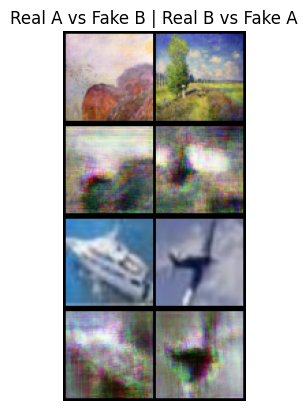

[Epoch 1/10] [Batch 10/125] [D loss : 0.313289] [G loss : 4.789945 - (adv : 1.032596, cycle : 0.261436, identity : 0.228598)]


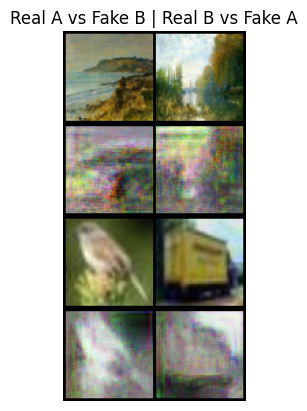

[Epoch 1/10] [Batch 20/125] [D loss : 0.401634] [G loss : 4.465620 - (adv : 0.747709, cycle : 0.251988, identity : 0.239606)]


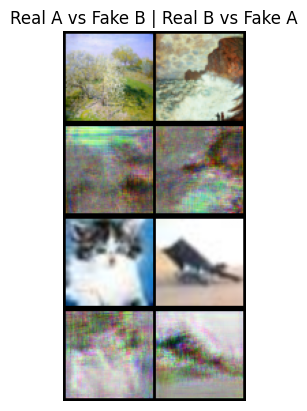

[Epoch 1/10] [Batch 30/125] [D loss : 0.445198] [G loss : 5.727858 - (adv : 0.668662, cycle : 0.342998, identity : 0.325844)]


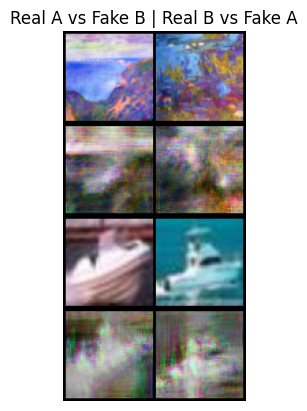

[Epoch 1/10] [Batch 40/125] [D loss : 0.409887] [G loss : 4.871811 - (adv : 0.779618, cycle : 0.284276, identity : 0.249886)]


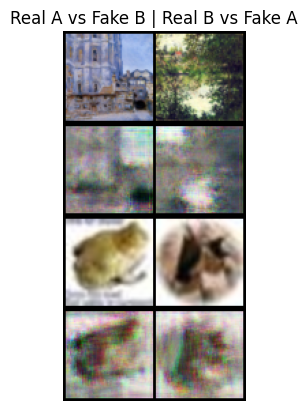

[Epoch 1/10] [Batch 50/125] [D loss : 0.450628] [G loss : 4.351930 - (adv : 0.472341, cycle : 0.263377, identity : 0.249163)]


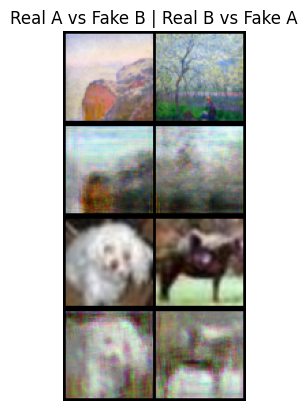

[Epoch 1/10] [Batch 60/125] [D loss : 0.281082] [G loss : 3.738536 - (adv : 0.779713, cycle : 0.203616, identity : 0.184532)]


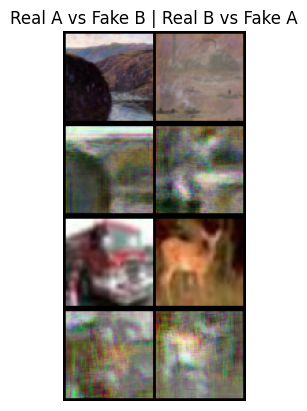

[Epoch 1/10] [Batch 70/125] [D loss : 0.405309] [G loss : 4.477781 - (adv : 0.639192, cycle : 0.260186, identity : 0.247345)]


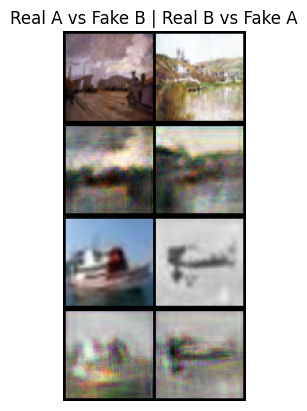

[Epoch 1/10] [Batch 80/125] [D loss : 0.278813] [G loss : 4.695271 - (adv : 0.403119, cycle : 0.287146, identity : 0.284138)]


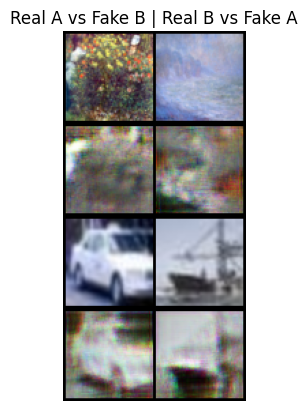

[Epoch 1/10] [Batch 90/125] [D loss : 0.254839] [G loss : 3.903351 - (adv : 0.507479, cycle : 0.234715, identity : 0.209745)]


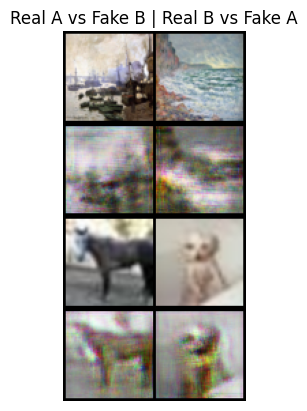

[Epoch 1/10] [Batch 100/125] [D loss : 0.294067] [G loss : 5.352162 - (adv : 0.754063, cycle : 0.308788, identity : 0.302045)]


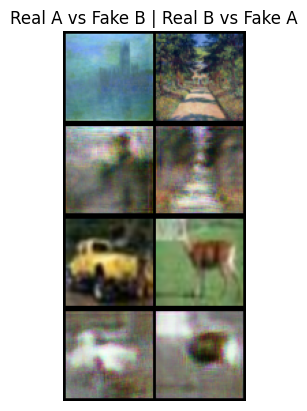

[Epoch 1/10] [Batch 110/125] [D loss : 0.349665] [G loss : 4.602394 - (adv : 0.440717, cycle : 0.284699, identity : 0.262937)]


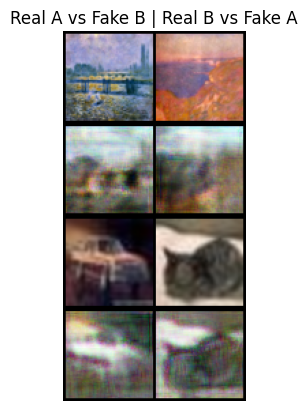

[Epoch 1/10] [Batch 120/125] [D loss : 0.236706] [G loss : 4.658549 - (adv : 0.625086, cycle : 0.276670, identity : 0.253353)]


  0%|          | 0/125 [00:00<?, ?it/s]

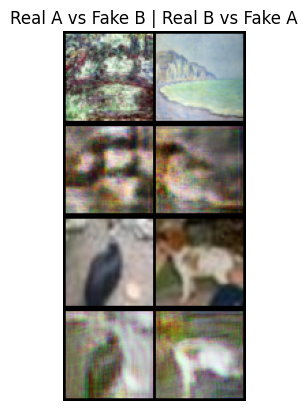

[Epoch 2/10] [Batch 10/125] [D loss : 0.210863] [G loss : 5.739680 - (adv : 0.660076, cycle : 0.350308, identity : 0.315305)]


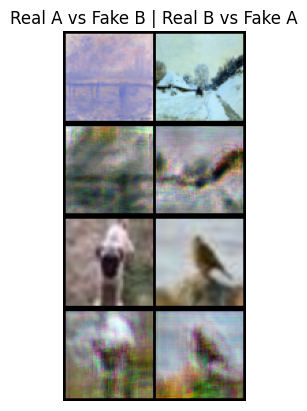

[Epoch 2/10] [Batch 20/125] [D loss : 0.179575] [G loss : 4.322853 - (adv : 0.566986, cycle : 0.248779, identity : 0.253616)]


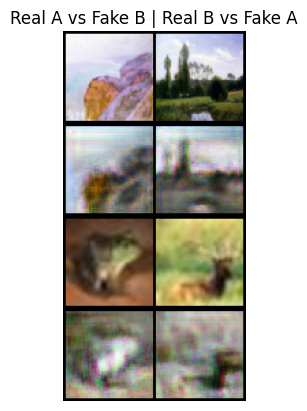

[Epoch 2/10] [Batch 30/125] [D loss : 0.305574] [G loss : 4.472164 - (adv : 0.408921, cycle : 0.275234, identity : 0.262180)]


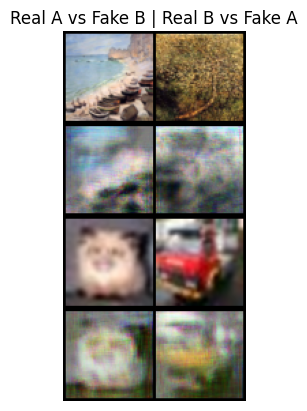

[Epoch 2/10] [Batch 40/125] [D loss : 0.146320] [G loss : 5.837952 - (adv : 0.921576, cycle : 0.326199, identity : 0.330877)]


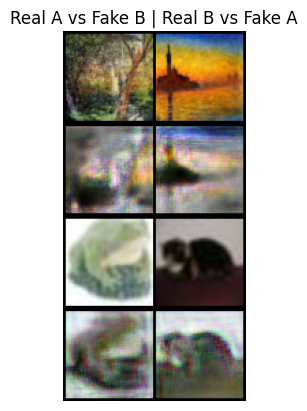

[Epoch 2/10] [Batch 50/125] [D loss : 0.256064] [G loss : 3.681851 - (adv : 0.432923, cycle : 0.219565, identity : 0.210655)]


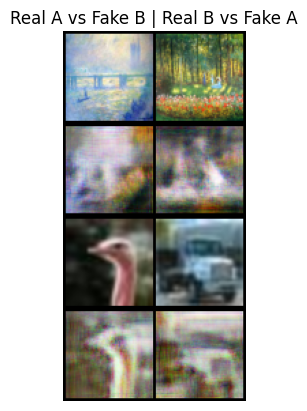

[Epoch 2/10] [Batch 60/125] [D loss : 0.255728] [G loss : 4.938978 - (adv : 0.600972, cycle : 0.314169, identity : 0.239264)]


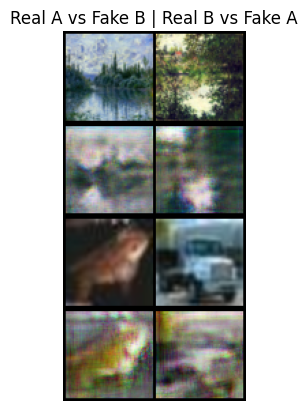

[Epoch 2/10] [Batch 70/125] [D loss : 0.337416] [G loss : 4.429867 - (adv : 0.586524, cycle : 0.257242, identity : 0.254184)]


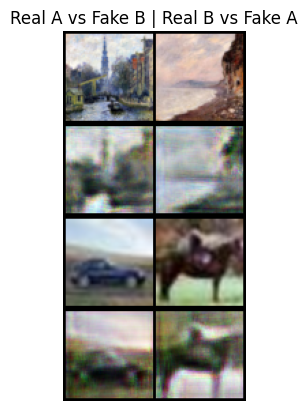

[Epoch 2/10] [Batch 80/125] [D loss : 0.280322] [G loss : 4.248483 - (adv : 0.491345, cycle : 0.263419, identity : 0.224590)]


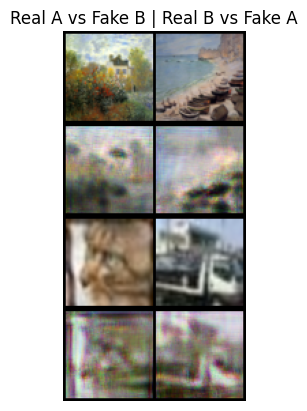

[Epoch 2/10] [Batch 90/125] [D loss : 0.277611] [G loss : 4.413692 - (adv : 0.575802, cycle : 0.257383, identity : 0.252813)]


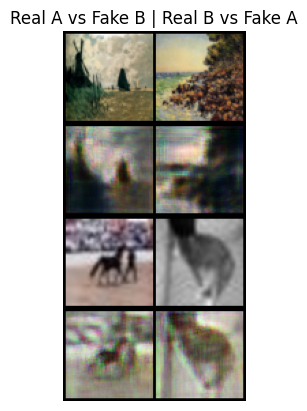

[Epoch 2/10] [Batch 100/125] [D loss : 0.309380] [G loss : 4.812881 - (adv : 0.408129, cycle : 0.299295, identity : 0.282360)]


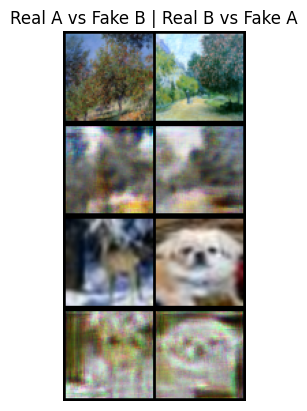

[Epoch 2/10] [Batch 110/125] [D loss : 0.203682] [G loss : 3.973500 - (adv : 0.598644, cycle : 0.229519, identity : 0.215933)]


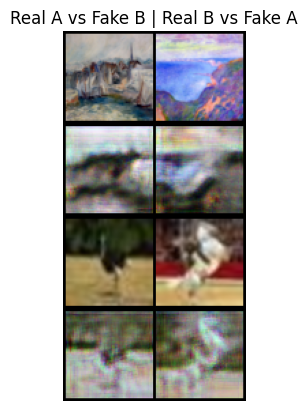

[Epoch 2/10] [Batch 120/125] [D loss : 0.190597] [G loss : 4.131272 - (adv : 0.665924, cycle : 0.235618, identity : 0.221835)]


  0%|          | 0/125 [00:00<?, ?it/s]

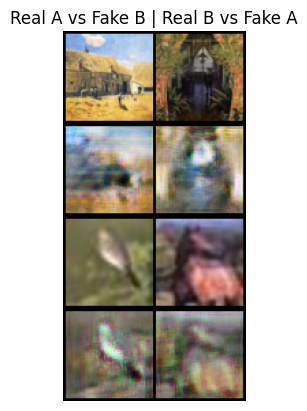

[Epoch 3/10] [Batch 10/125] [D loss : 0.266259] [G loss : 3.403700 - (adv : 0.519723, cycle : 0.195484, identity : 0.185827)]


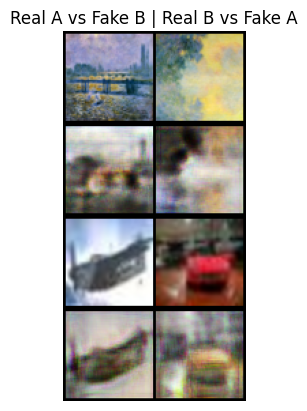

[Epoch 3/10] [Batch 20/125] [D loss : 0.302775] [G loss : 3.923394 - (adv : 0.526955, cycle : 0.233309, identity : 0.212669)]


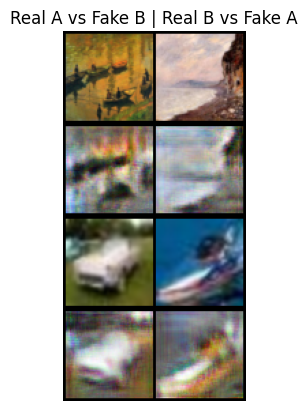

[Epoch 3/10] [Batch 30/125] [D loss : 0.228741] [G loss : 4.399234 - (adv : 0.701380, cycle : 0.244375, identity : 0.250821)]


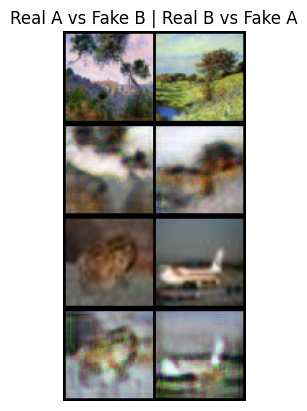

[Epoch 3/10] [Batch 40/125] [D loss : 0.164589] [G loss : 5.273779 - (adv : 0.633655, cycle : 0.312327, identity : 0.303371)]


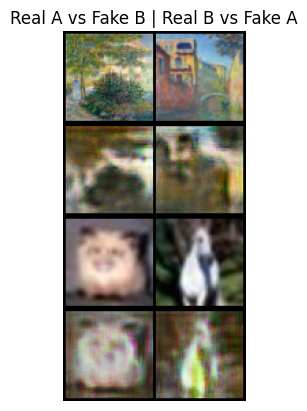

[Epoch 3/10] [Batch 50/125] [D loss : 0.200071] [G loss : 5.913902 - (adv : 0.564142, cycle : 0.354241, identity : 0.361471)]


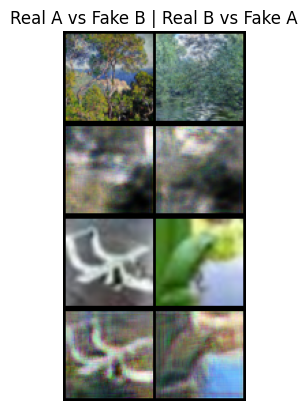

[Epoch 3/10] [Batch 60/125] [D loss : 0.256658] [G loss : 3.880352 - (adv : 0.664434, cycle : 0.219527, identity : 0.204130)]


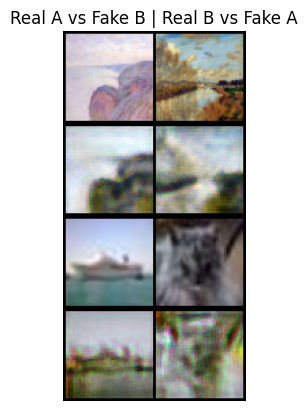

[Epoch 3/10] [Batch 70/125] [D loss : 0.388303] [G loss : 4.989442 - (adv : 0.323399, cycle : 0.305966, identity : 0.321277)]


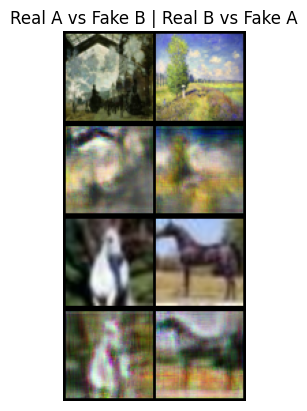

[Epoch 3/10] [Batch 80/125] [D loss : 0.170327] [G loss : 4.719450 - (adv : 0.652300, cycle : 0.284638, identity : 0.244155)]


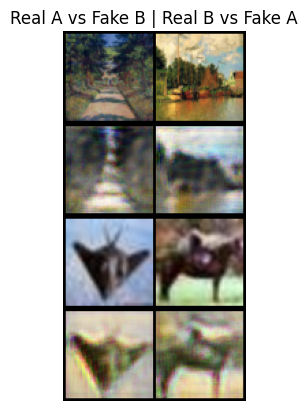

[Epoch 3/10] [Batch 90/125] [D loss : 0.229304] [G loss : 4.357784 - (adv : 0.643153, cycle : 0.263885, identity : 0.215156)]


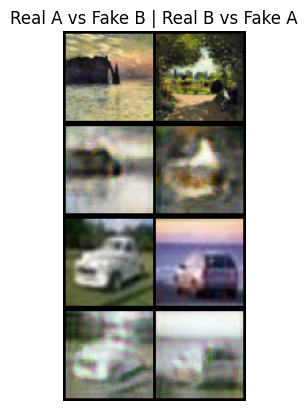

[Epoch 3/10] [Batch 100/125] [D loss : 0.194439] [G loss : 4.404996 - (adv : 0.643868, cycle : 0.252692, identity : 0.246842)]


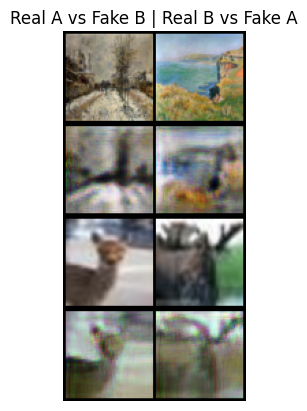

[Epoch 3/10] [Batch 110/125] [D loss : 0.310468] [G loss : 3.673527 - (adv : 0.400373, cycle : 0.219482, identity : 0.215666)]


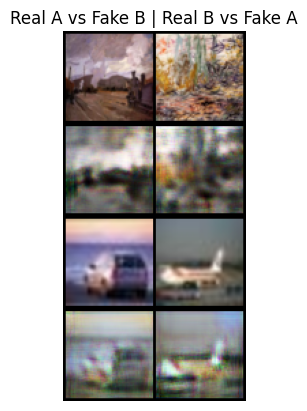

[Epoch 3/10] [Batch 120/125] [D loss : 0.174892] [G loss : 4.219139 - (adv : 0.948381, cycle : 0.223450, identity : 0.207251)]


  0%|          | 0/125 [00:00<?, ?it/s]

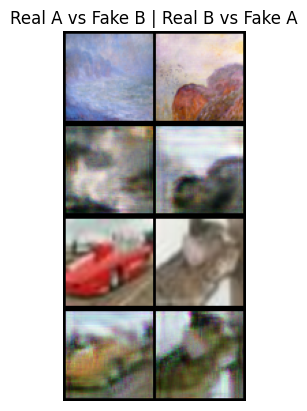

[Epoch 4/10] [Batch 10/125] [D loss : 0.181791] [G loss : 3.704720 - (adv : 0.559627, cycle : 0.225985, identity : 0.177048)]


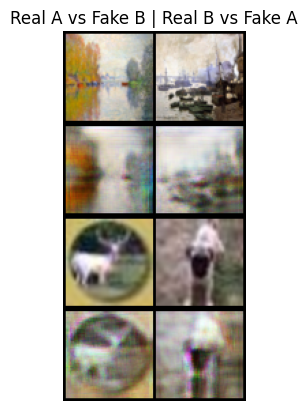

[Epoch 4/10] [Batch 20/125] [D loss : 0.181981] [G loss : 3.326853 - (adv : 0.546354, cycle : 0.188734, identity : 0.178631)]


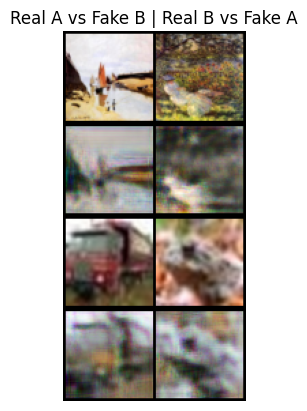

[Epoch 4/10] [Batch 30/125] [D loss : 0.217267] [G loss : 4.393483 - (adv : 0.712351, cycle : 0.247436, identity : 0.241354)]


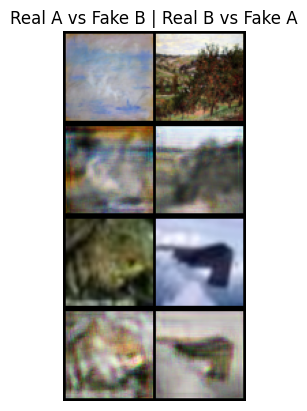

[Epoch 4/10] [Batch 40/125] [D loss : 0.231273] [G loss : 4.010873 - (adv : 0.758563, cycle : 0.221643, identity : 0.207175)]


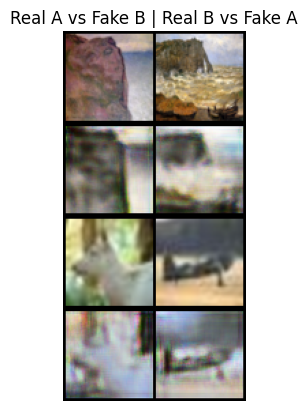

[Epoch 4/10] [Batch 50/125] [D loss : 0.121447] [G loss : 4.908607 - (adv : 0.543862, cycle : 0.288753, identity : 0.295443)]


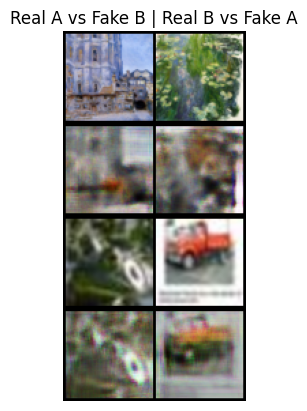

[Epoch 4/10] [Batch 60/125] [D loss : 0.406842] [G loss : 3.475448 - (adv : 0.394605, cycle : 0.209079, identity : 0.198010)]


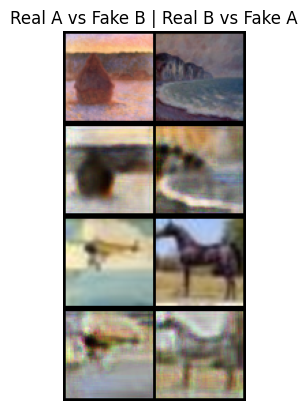

[Epoch 4/10] [Batch 70/125] [D loss : 0.198450] [G loss : 3.763999 - (adv : 0.525244, cycle : 0.218863, identity : 0.210025)]


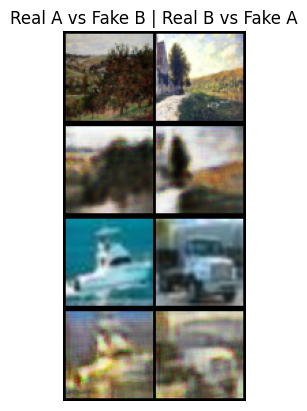

[Epoch 4/10] [Batch 80/125] [D loss : 0.133374] [G loss : 5.524800 - (adv : 0.587153, cycle : 0.345049, identity : 0.297432)]


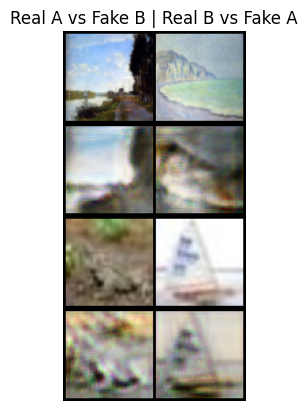

[Epoch 4/10] [Batch 90/125] [D loss : 0.215342] [G loss : 4.327513 - (adv : 0.452833, cycle : 0.264739, identity : 0.245458)]


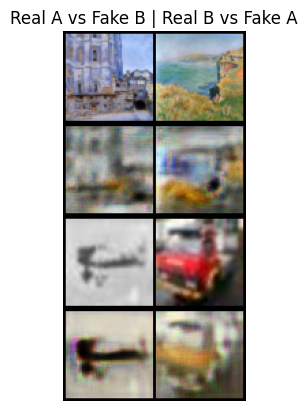

[Epoch 4/10] [Batch 100/125] [D loss : 0.202052] [G loss : 4.327884 - (adv : 0.574814, cycle : 0.253596, identity : 0.243422)]


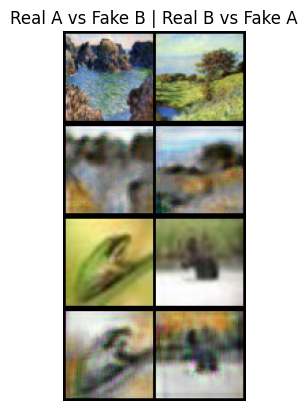

[Epoch 4/10] [Batch 110/125] [D loss : 0.250969] [G loss : 4.463414 - (adv : 0.536332, cycle : 0.267056, identity : 0.251304)]


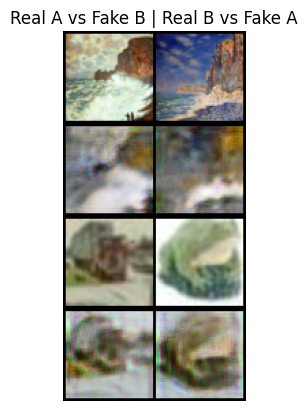

[Epoch 4/10] [Batch 120/125] [D loss : 0.167254] [G loss : 3.932704 - (adv : 0.542785, cycle : 0.233995, identity : 0.209994)]


  0%|          | 0/125 [00:00<?, ?it/s]

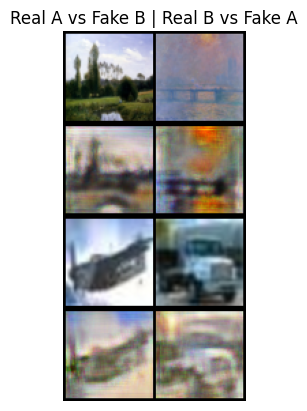

[Epoch 5/10] [Batch 10/125] [D loss : 0.130198] [G loss : 4.798378 - (adv : 0.680385, cycle : 0.278832, identity : 0.265934)]


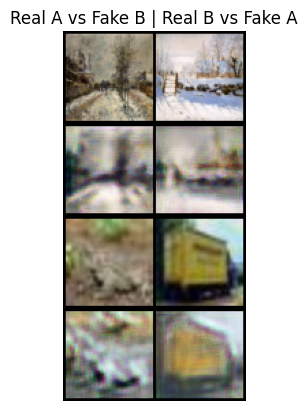

[Epoch 5/10] [Batch 20/125] [D loss : 0.166994] [G loss : 4.345611 - (adv : 0.682556, cycle : 0.246579, identity : 0.239454)]


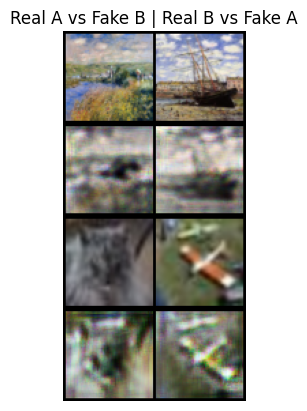

[Epoch 5/10] [Batch 30/125] [D loss : 0.188925] [G loss : 4.041501 - (adv : 0.606665, cycle : 0.229032, identity : 0.228904)]


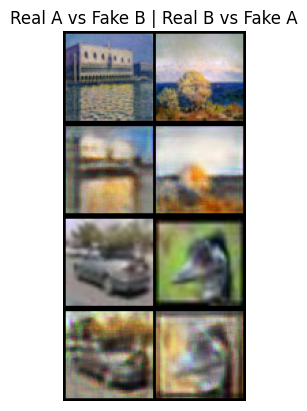

[Epoch 5/10] [Batch 40/125] [D loss : 0.185205] [G loss : 3.881506 - (adv : 0.585324, cycle : 0.225534, identity : 0.208168)]


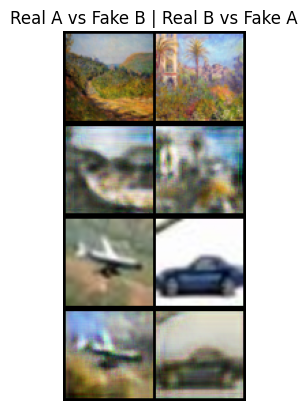

[Epoch 5/10] [Batch 50/125] [D loss : 0.242244] [G loss : 3.505163 - (adv : 0.537381, cycle : 0.199830, identity : 0.193896)]


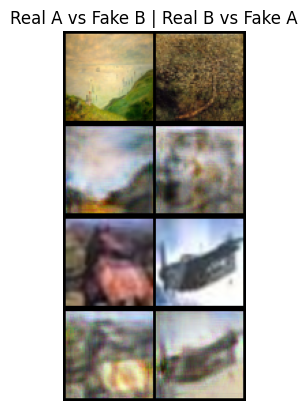

[Epoch 5/10] [Batch 60/125] [D loss : 0.239030] [G loss : 3.683954 - (adv : 0.523262, cycle : 0.224699, identity : 0.182741)]


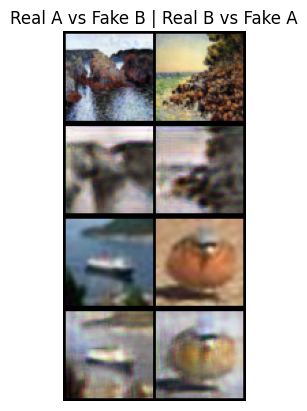

[Epoch 5/10] [Batch 70/125] [D loss : 0.232896] [G loss : 3.541981 - (adv : 0.437682, cycle : 0.218831, identity : 0.183198)]


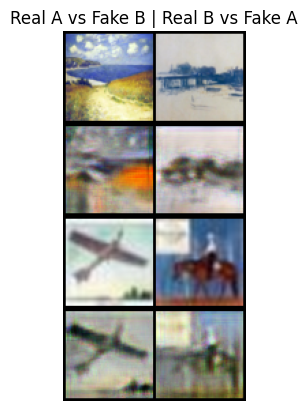

[Epoch 5/10] [Batch 80/125] [D loss : 0.271742] [G loss : 3.649942 - (adv : 0.402739, cycle : 0.212622, identity : 0.224196)]


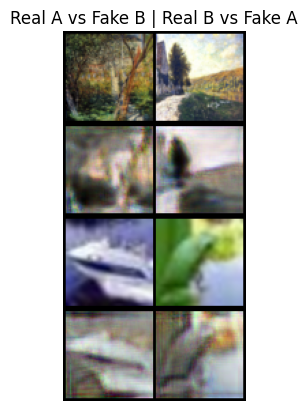

[Epoch 5/10] [Batch 90/125] [D loss : 0.120130] [G loss : 3.955637 - (adv : 0.759650, cycle : 0.227893, identity : 0.183411)]


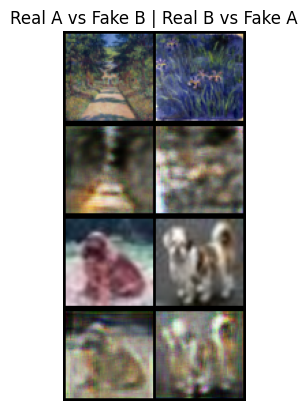

[Epoch 5/10] [Batch 100/125] [D loss : 0.126114] [G loss : 4.469326 - (adv : 0.838255, cycle : 0.248660, identity : 0.228894)]


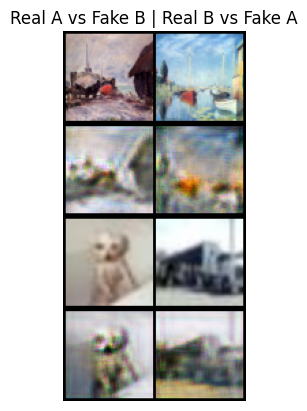

[Epoch 5/10] [Batch 110/125] [D loss : 0.254319] [G loss : 3.638470 - (adv : 0.490078, cycle : 0.216457, identity : 0.196763)]


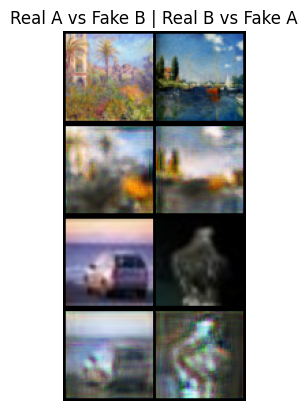

[Epoch 5/10] [Batch 120/125] [D loss : 0.275190] [G loss : 4.064710 - (adv : 0.408804, cycle : 0.248969, identity : 0.233243)]


  0%|          | 0/125 [00:00<?, ?it/s]

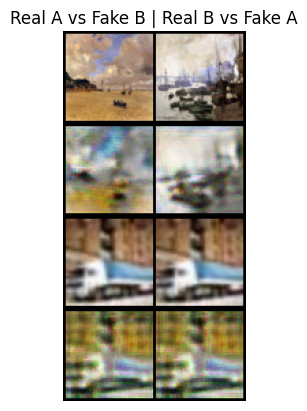

[Epoch 6/10] [Batch 10/125] [D loss : 0.137364] [G loss : 5.015988 - (adv : 0.583762, cycle : 0.301526, identity : 0.283394)]


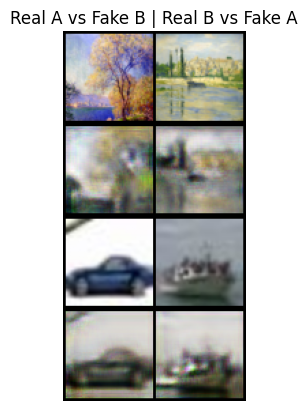

[Epoch 6/10] [Batch 20/125] [D loss : 0.154172] [G loss : 4.647504 - (adv : 0.515628, cycle : 0.287165, identity : 0.252045)]


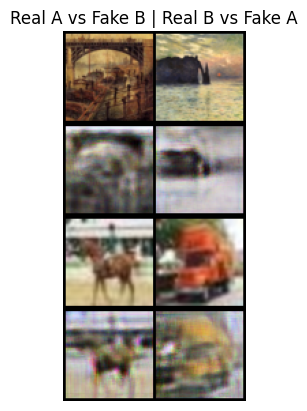

[Epoch 6/10] [Batch 30/125] [D loss : 0.111458] [G loss : 4.356894 - (adv : 0.813127, cycle : 0.237419, identity : 0.233916)]


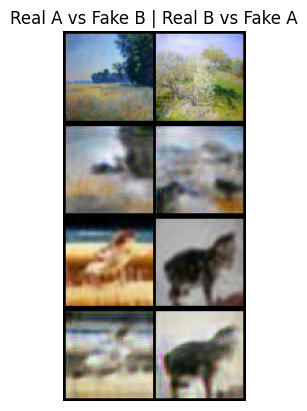

[Epoch 6/10] [Batch 40/125] [D loss : 0.231635] [G loss : 3.145433 - (adv : 0.358680, cycle : 0.188245, identity : 0.180861)]


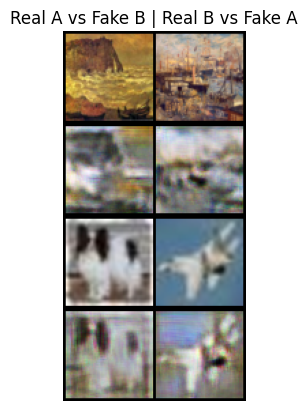

[Epoch 6/10] [Batch 50/125] [D loss : 0.156734] [G loss : 5.434855 - (adv : 0.646635, cycle : 0.325723, identity : 0.306198)]


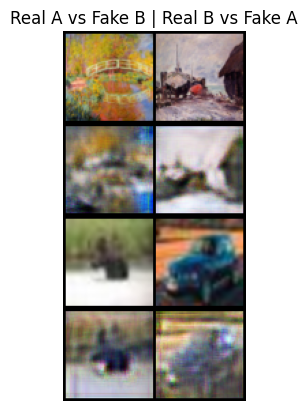

[Epoch 6/10] [Batch 60/125] [D loss : 0.196441] [G loss : 3.557700 - (adv : 0.499220, cycle : 0.210667, identity : 0.190362)]


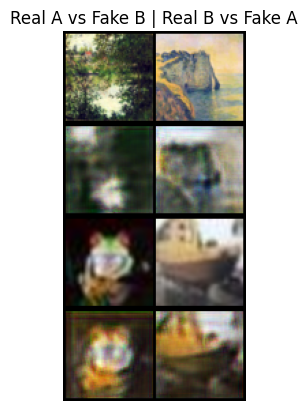

[Epoch 6/10] [Batch 70/125] [D loss : 0.165223] [G loss : 3.664988 - (adv : 0.555991, cycle : 0.212982, identity : 0.195836)]


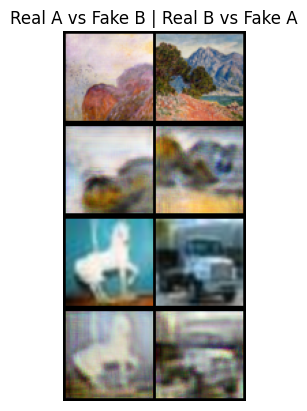

[Epoch 6/10] [Batch 80/125] [D loss : 0.212117] [G loss : 2.949646 - (adv : 0.456215, cycle : 0.170814, identity : 0.157058)]


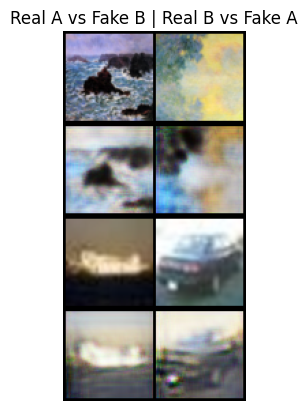

[Epoch 6/10] [Batch 90/125] [D loss : 0.203497] [G loss : 3.669777 - (adv : 0.689866, cycle : 0.196751, identity : 0.202481)]


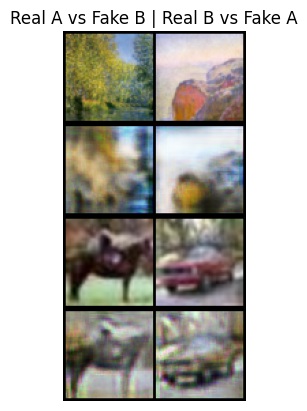

[Epoch 6/10] [Batch 100/125] [D loss : 0.116961] [G loss : 5.906378 - (adv : 0.781492, cycle : 0.343118, identity : 0.338741)]


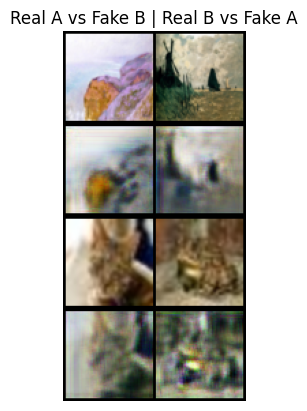

[Epoch 6/10] [Batch 110/125] [D loss : 0.194588] [G loss : 3.030437 - (adv : 0.387963, cycle : 0.176920, identity : 0.174654)]


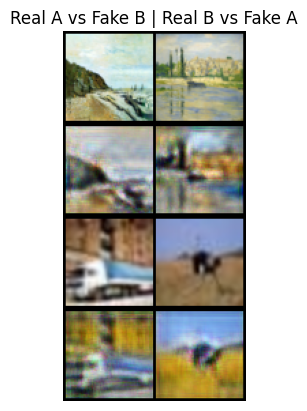

[Epoch 6/10] [Batch 120/125] [D loss : 0.199478] [G loss : 3.991611 - (adv : 0.399260, cycle : 0.257484, identity : 0.203502)]


  0%|          | 0/125 [00:00<?, ?it/s]

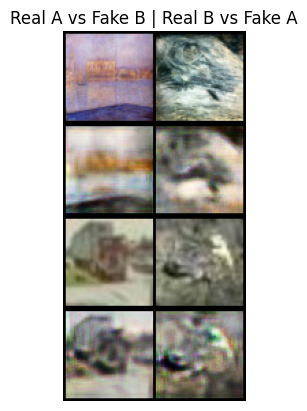

[Epoch 7/10] [Batch 10/125] [D loss : 0.182686] [G loss : 3.906410 - (adv : 0.556152, cycle : 0.225583, identity : 0.218886)]


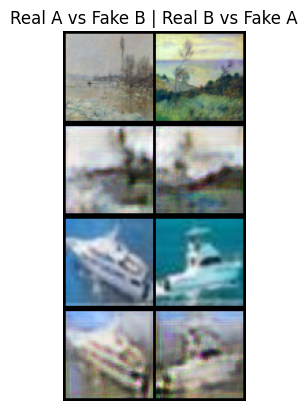

[Epoch 7/10] [Batch 20/125] [D loss : 0.164794] [G loss : 3.465797 - (adv : 0.562039, cycle : 0.200137, identity : 0.180477)]


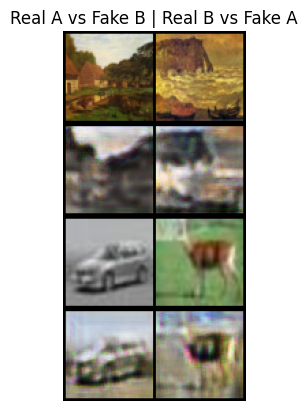

[Epoch 7/10] [Batch 30/125] [D loss : 0.270709] [G loss : 3.840717 - (adv : 0.455807, cycle : 0.236361, identity : 0.204261)]


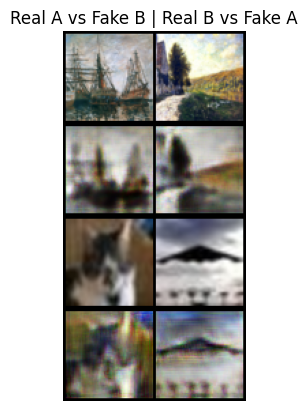

[Epoch 7/10] [Batch 40/125] [D loss : 0.234647] [G loss : 3.310957 - (adv : 0.674339, cycle : 0.181910, identity : 0.163503)]


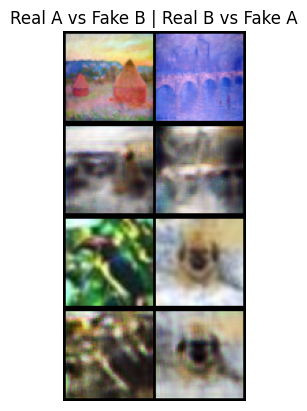

[Epoch 7/10] [Batch 50/125] [D loss : 0.137283] [G loss : 3.743687 - (adv : 0.701913, cycle : 0.225769, identity : 0.156817)]


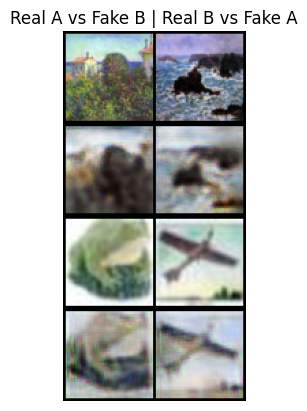

[Epoch 7/10] [Batch 60/125] [D loss : 0.238231] [G loss : 3.745211 - (adv : 0.526095, cycle : 0.227582, identity : 0.188659)]


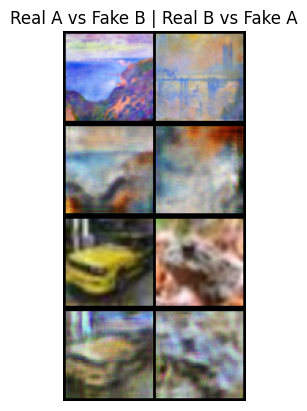

[Epoch 7/10] [Batch 70/125] [D loss : 0.134307] [G loss : 3.875884 - (adv : 0.606461, cycle : 0.217264, identity : 0.219356)]


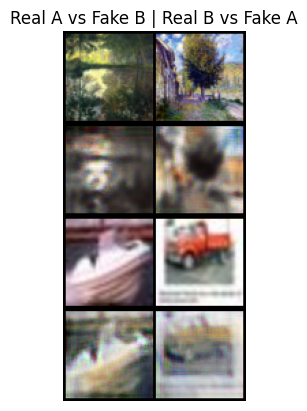

[Epoch 7/10] [Batch 80/125] [D loss : 0.138209] [G loss : 3.098279 - (adv : 0.643225, cycle : 0.166247, identity : 0.158516)]


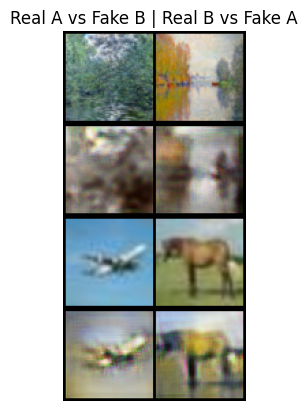

[Epoch 7/10] [Batch 90/125] [D loss : 0.155481] [G loss : 3.237043 - (adv : 0.543761, cycle : 0.186017, identity : 0.166622)]


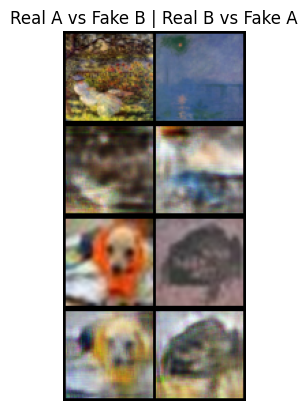

[Epoch 7/10] [Batch 100/125] [D loss : 0.211211] [G loss : 3.140240 - (adv : 0.532727, cycle : 0.171776, identity : 0.177950)]


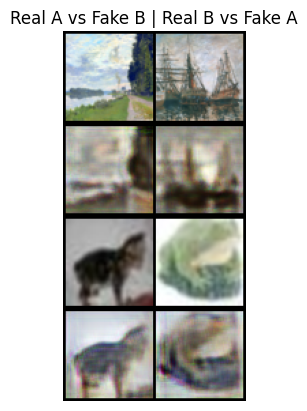

[Epoch 7/10] [Batch 110/125] [D loss : 0.196141] [G loss : 3.881567 - (adv : 0.485428, cycle : 0.236076, identity : 0.207075)]


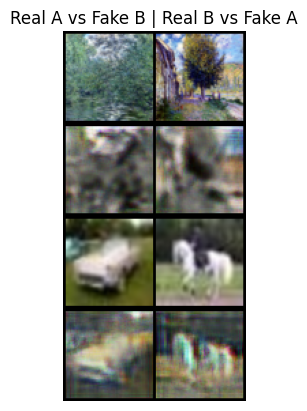

[Epoch 7/10] [Batch 120/125] [D loss : 0.159223] [G loss : 4.063513 - (adv : 0.556974, cycle : 0.243788, identity : 0.213731)]


  0%|          | 0/125 [00:00<?, ?it/s]

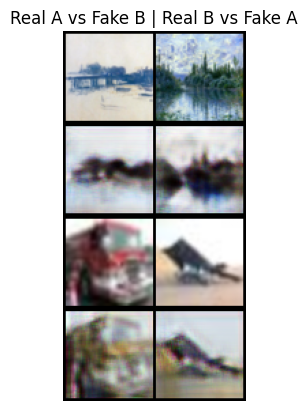

[Epoch 8/10] [Batch 10/125] [D loss : 0.139469] [G loss : 4.008760 - (adv : 0.735466, cycle : 0.228718, identity : 0.197223)]


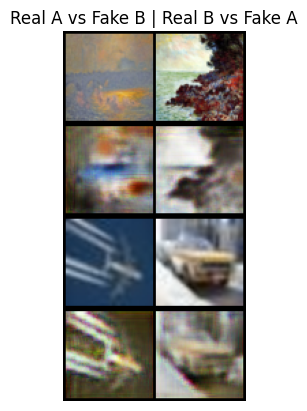

[Epoch 8/10] [Batch 20/125] [D loss : 0.222634] [G loss : 4.538376 - (adv : 0.422477, cycle : 0.279145, identity : 0.264890)]


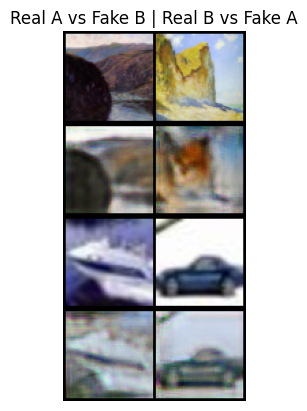

[Epoch 8/10] [Batch 30/125] [D loss : 0.187617] [G loss : 3.556805 - (adv : 0.784449, cycle : 0.194359, identity : 0.165753)]


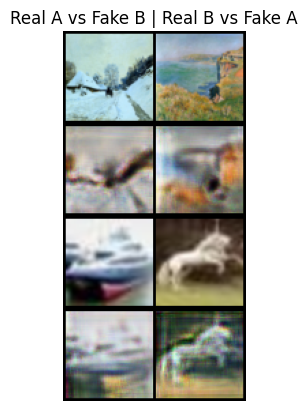

[Epoch 8/10] [Batch 40/125] [D loss : 0.270141] [G loss : 3.981239 - (adv : 0.662337, cycle : 0.225436, identity : 0.212908)]


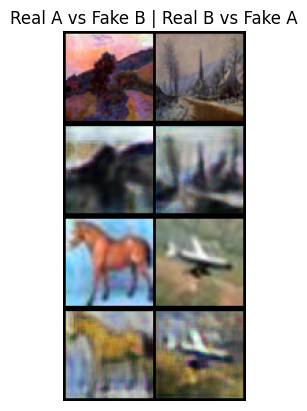

[Epoch 8/10] [Batch 50/125] [D loss : 0.144838] [G loss : 3.602165 - (adv : 0.585310, cycle : 0.193928, identity : 0.215516)]


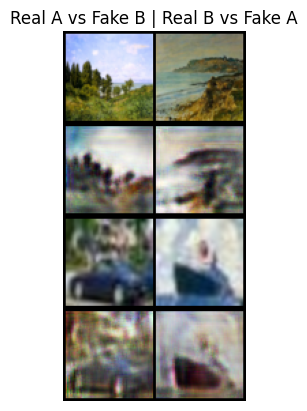

[Epoch 8/10] [Batch 60/125] [D loss : 0.223543] [G loss : 3.839235 - (adv : 0.560422, cycle : 0.217302, identity : 0.221159)]


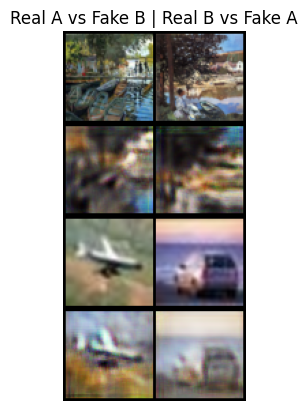

[Epoch 8/10] [Batch 70/125] [D loss : 0.173977] [G loss : 3.274869 - (adv : 0.487200, cycle : 0.188433, identity : 0.180668)]


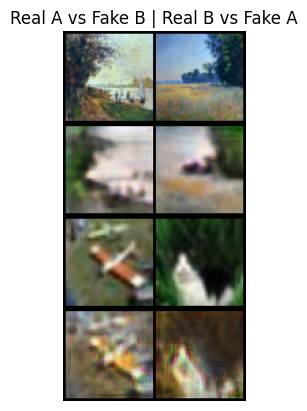

[Epoch 8/10] [Batch 80/125] [D loss : 0.115268] [G loss : 3.175299 - (adv : 0.706263, cycle : 0.166890, identity : 0.160027)]


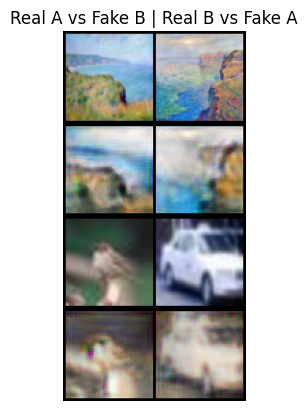

[Epoch 8/10] [Batch 90/125] [D loss : 0.149408] [G loss : 3.415697 - (adv : 0.580780, cycle : 0.198890, identity : 0.169203)]


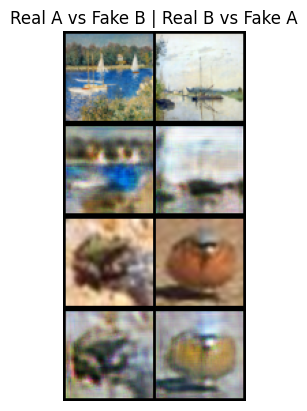

[Epoch 8/10] [Batch 100/125] [D loss : 0.183982] [G loss : 4.190671 - (adv : 0.869073, cycle : 0.228239, identity : 0.207842)]


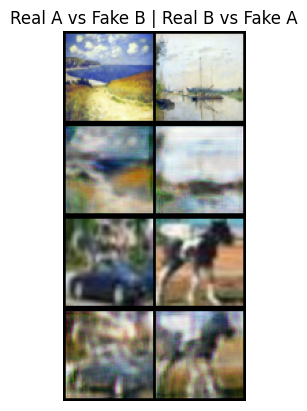

[Epoch 8/10] [Batch 110/125] [D loss : 0.198659] [G loss : 3.708686 - (adv : 0.521634, cycle : 0.211256, identity : 0.214898)]


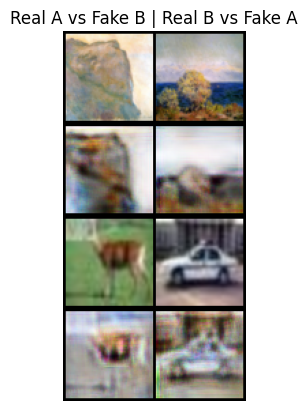

[Epoch 8/10] [Batch 120/125] [D loss : 0.167249] [G loss : 4.345005 - (adv : 0.639979, cycle : 0.251568, identity : 0.237868)]


  0%|          | 0/125 [00:00<?, ?it/s]

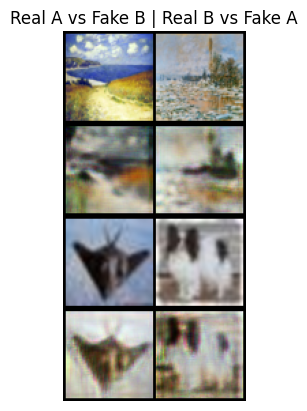

[Epoch 9/10] [Batch 10/125] [D loss : 0.112945] [G loss : 3.996185 - (adv : 0.910816, cycle : 0.207521, identity : 0.202032)]


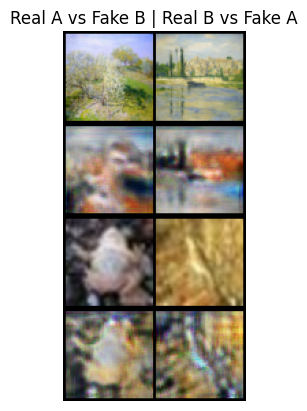

[Epoch 9/10] [Batch 20/125] [D loss : 0.236904] [G loss : 4.043004 - (adv : 0.677556, cycle : 0.233713, identity : 0.205664)]


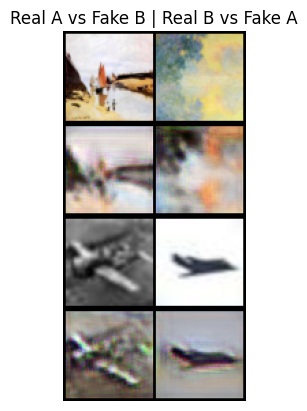

[Epoch 9/10] [Batch 30/125] [D loss : 0.148082] [G loss : 4.894836 - (adv : 0.933399, cycle : 0.277686, identity : 0.236916)]


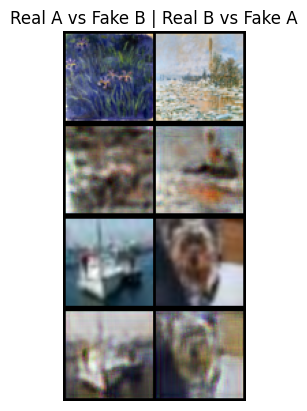

[Epoch 9/10] [Batch 40/125] [D loss : 0.140087] [G loss : 4.618717 - (adv : 0.724829, cycle : 0.267209, identity : 0.244360)]


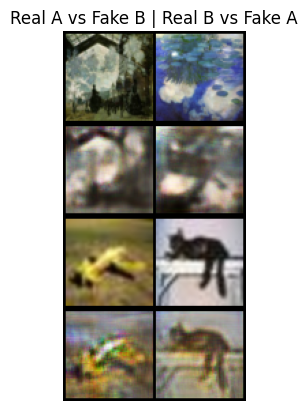

[Epoch 9/10] [Batch 50/125] [D loss : 0.106704] [G loss : 3.485298 - (adv : 0.713414, cycle : 0.190631, identity : 0.173116)]


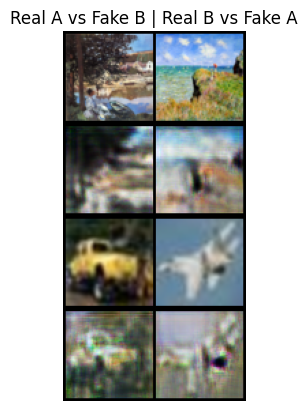

[Epoch 9/10] [Batch 60/125] [D loss : 0.181956] [G loss : 3.500559 - (adv : 0.712115, cycle : 0.187760, identity : 0.182170)]


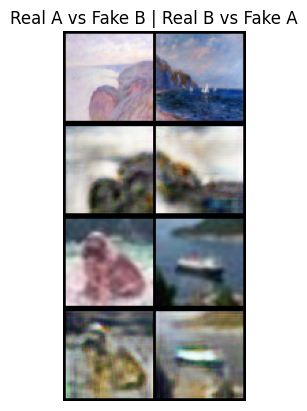

[Epoch 9/10] [Batch 70/125] [D loss : 0.129024] [G loss : 5.021943 - (adv : 0.662286, cycle : 0.294947, identity : 0.282037)]


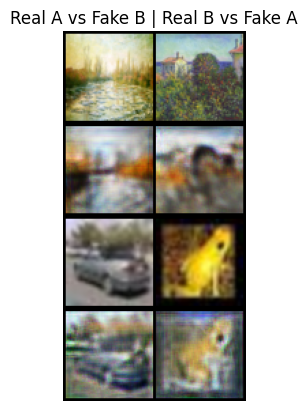

[Epoch 9/10] [Batch 80/125] [D loss : 0.124198] [G loss : 3.683917 - (adv : 0.639259, cycle : 0.207280, identity : 0.194372)]


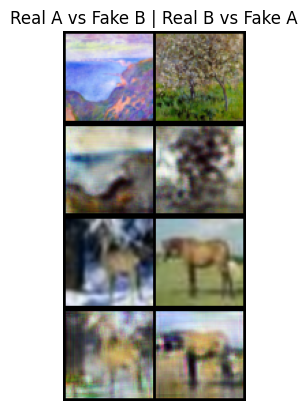

[Epoch 9/10] [Batch 90/125] [D loss : 0.168266] [G loss : 4.593702 - (adv : 0.578163, cycle : 0.261003, identity : 0.281102)]


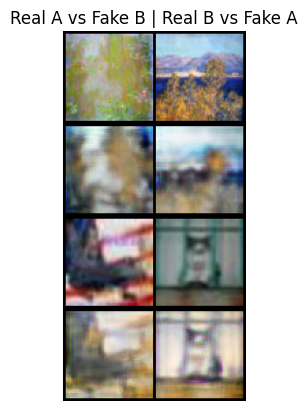

[Epoch 9/10] [Batch 100/125] [D loss : 0.179986] [G loss : 6.046178 - (adv : 0.645731, cycle : 0.361328, identity : 0.357434)]


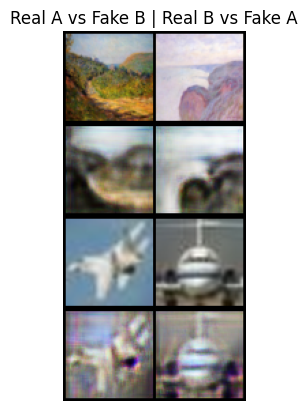

[Epoch 9/10] [Batch 110/125] [D loss : 0.151688] [G loss : 3.833632 - (adv : 0.728667, cycle : 0.210718, identity : 0.199557)]


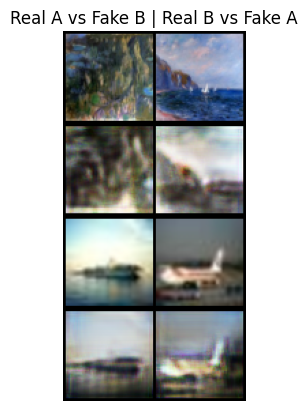

[Epoch 9/10] [Batch 120/125] [D loss : 0.098824] [G loss : 4.112583 - (adv : 0.766972, cycle : 0.225131, identity : 0.218859)]


  0%|          | 0/125 [00:00<?, ?it/s]

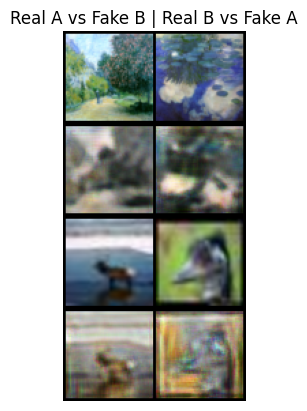

[Epoch 10/10] [Batch 10/125] [D loss : 0.198007] [G loss : 3.560477 - (adv : 0.578019, cycle : 0.195537, identity : 0.205418)]


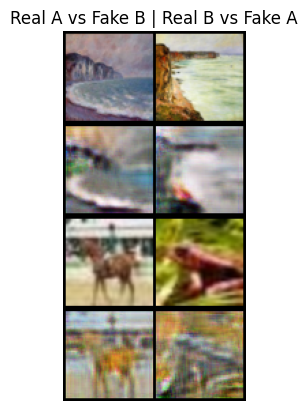

[Epoch 10/10] [Batch 20/125] [D loss : 0.126641] [G loss : 3.616828 - (adv : 0.723045, cycle : 0.197795, identity : 0.183167)]


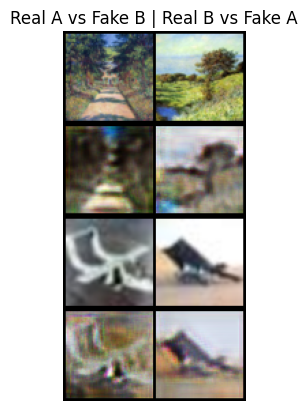

[Epoch 10/10] [Batch 30/125] [D loss : 0.236667] [G loss : 3.211403 - (adv : 0.671620, cycle : 0.171951, identity : 0.164056)]


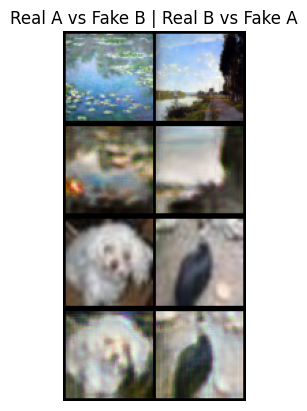

[Epoch 10/10] [Batch 40/125] [D loss : 0.204798] [G loss : 3.628597 - (adv : 0.402053, cycle : 0.221617, identity : 0.202076)]


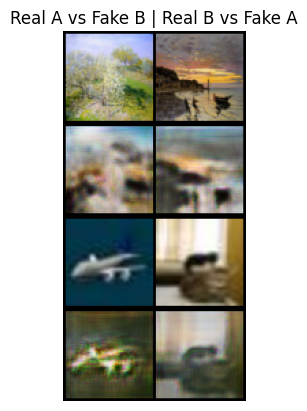

[Epoch 10/10] [Batch 50/125] [D loss : 0.130706] [G loss : 4.060385 - (adv : 0.808307, cycle : 0.231052, identity : 0.188311)]


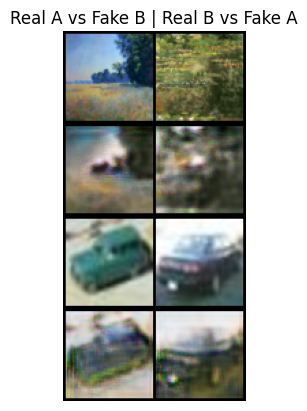

[Epoch 10/10] [Batch 60/125] [D loss : 0.114318] [G loss : 3.521644 - (adv : 0.894429, cycle : 0.179949, identity : 0.165545)]


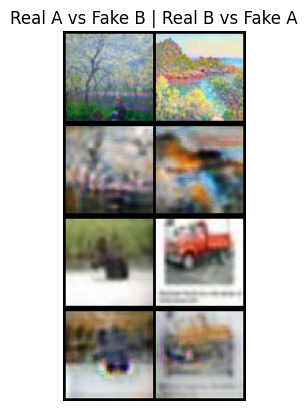

[Epoch 10/10] [Batch 70/125] [D loss : 0.095532] [G loss : 3.143054 - (adv : 0.815858, cycle : 0.157487, identity : 0.150465)]


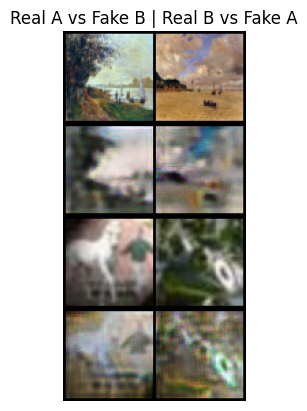

[Epoch 10/10] [Batch 80/125] [D loss : 0.088688] [G loss : 4.319355 - (adv : 0.879702, cycle : 0.217751, identity : 0.252429)]


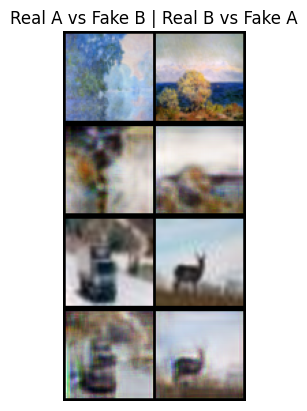

[Epoch 10/10] [Batch 90/125] [D loss : 0.212284] [G loss : 4.048057 - (adv : 0.563948, cycle : 0.227384, identity : 0.242054)]


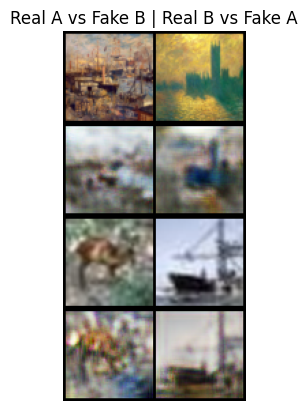

[Epoch 10/10] [Batch 100/125] [D loss : 0.205286] [G loss : 3.642127 - (adv : 0.498982, cycle : 0.208700, identity : 0.211229)]


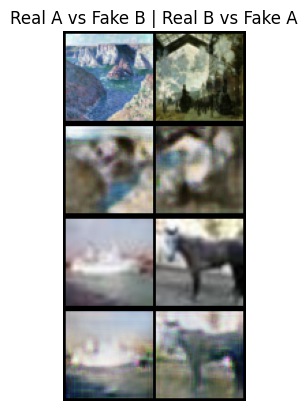

[Epoch 10/10] [Batch 110/125] [D loss : 0.132102] [G loss : 3.613827 - (adv : 0.611925, cycle : 0.203222, identity : 0.193937)]


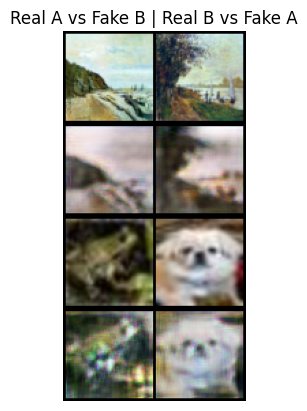

[Epoch 10/10] [Batch 120/125] [D loss : 0.126341] [G loss : 4.372763 - (adv : 0.767210, cycle : 0.250305, identity : 0.220500)]


In [ ]:
traindataloader = mon_Cifar_train_dataloader
step = 0

for epoch in range(n_epochs):
    alpha = 1
    for i, batch in enumerate(tqdm(traindataloader)):

        if epoch == 0:
          alpha = i/(len(traindataloader))



        # Set model input
        real_A = batch['A'].type(Tensor)



        real_B = batch['B'].type(Tensor)
        # real_A = F.interpolate(real_A, scale_factor=1/2**(step), mode='bilinear', align_corners=False)
        # real_B = F.interpolate(real_B, scale_factor=1/2**(step), mode='bilinear', align_corners=False)

        valid = Tensor(np.ones((real_A.size(0), 1, 4, 4)))
        fake = Tensor(np.zeros((real_A.size(0), 1, 4, 4)))



        G_AB.train()
        G_BA.train()

        optimizer_G.zero_grad()


        loss_id_A = criterion_identity(G_BA(real_A, alpha, step), real_A)
        loss_id_B = criterion_identity(G_AB(real_B, alpha, step), real_B)
        loss_identity = (loss_id_A + loss_id_B)/2


        fake_B = G_AB(real_A, alpha, step)
        # print(fake_B.shape)
        # print(fake_B.shape, D_B(fake_B, 1, step).shape)
        loss_GAN_AB = criterion_GAN(D_B(fake_B, alpha, step), valid)

        fake_A = G_BA(real_B, 1, step)
        loss_GAN_BA = criterion_GAN(D_A(fake_A, alpha, step), valid)

        loss_GAN = (loss_GAN_AB + loss_GAN_BA)/2

        recov_A = G_BA(fake_B,alpha,step)
        loss_cycle_A = criterion_cycle(recov_A, real_A)
        recov_B = G_AB(fake_A,alpha,step)
        loss_cycle_B = criterion_cycle(recov_B, real_B)

        loss_cycle = (loss_cycle_A + loss_cycle_B)/2


        loss_G = loss_GAN + (10.0*loss_cycle) + (5.0*loss_identity)

        loss_G.backward()
        optimizer_G.step()


        optimizer_D_A.zero_grad()
        # print("haha", D_B(fake_B, 1, step),D_A(real_A, 1, step))

        loss_real = criterion_GAN(D_A(real_A, alpha, step), valid)
        loss_fake = criterion_GAN(D_A(fake_A.detach(), alpha, step), fake)

        loss_D_A = (loss_real + loss_fake)/2

        loss_D_A.backward()
        optimizer_D_A.step()

        optimizer_D_B.zero_grad()

        loss_real = criterion_GAN(D_B(real_B, alpha, step), valid)
        loss_fake = criterion_GAN(D_B(fake_B.detach(), alpha, step), fake)

        loss_D_B = (loss_real + loss_fake)/2

        loss_D_B.backward()
        optimizer_D_B.step()


        loss_D = (loss_D_A + loss_D_B)/2

        # print(loss_G.item(), loss_D.item())


        if (i+1) % 10 == 0:
            sample_images(traindataloader,step)
            print('[Epoch %d/%d] [Batch %d/%d] [D loss : %f] [G loss : %f - (adv : %f, cycle : %f, identity : %f)]'
                    %(epoch+1,n_epochs,
                      i+1,len(traindataloader),
                      loss_D.item(),
                      loss_G.item(),
                      loss_GAN.item(),
                      loss_cycle.item(),
                      loss_identity.item(),
                     ))



In [ ]:
!pip install torch torchvision torcheval
!pip install torch-fidelity
!pip install torchmetrics
!pip install torchmetrics[image]
# !pip install torchmetrics[image]

In [ ]:
import os
import torch
import torchvision.transforms as transforms
from torchvision.datasets import ImageFolder
from torchvision.models import inception_v3
from torch.utils.data import DataLoader
from torcheval.metrics import FrechetInceptionDistance
from PIL import Image


# def get_dataloader(image_dir, batch_size=32):
#     transform = transforms.Compose([
#         transforms.Resize((299, 299)),  # Resize to Inception-v3 input size
#         transforms.ToTensor(),
#         transforms.Normalize([0.5] * 3, [0.5] * 3)  # Normalize to [-1, 1]
#     ])
#     dataset = ImageFolder(image_dir, transform=transform)
#     return DataLoader(dataset, batch_size=batch_size, shuffle=False)


def calculate_fidis(traindataloader, testdataloader, batch_size=32, device='cuda'):
    device = torch.device(device if torch.cuda.is_available() else 'cpu')

    mytransform = transforms.Resize((299, 299))

    fid_metric = FrechetInceptionDistance().to(device)
    from torch import rand
    from torchmetrics.image.inception import InceptionScore
    # inception = InceptionScore()




    for batch in traindataloader:
        # print(real_A, real_B)
        real_A = batch["A"]
        real_B = batch["B"]

        real_A = mytransform(real_A.to(device))
        real_A = (real_A + 1)/2

        fid_metric.update(real_A, is_real=True)
        # real_B = real_B.to(device)
        # fake_A = G_BA(real_B, alpha, step)
        # fake_A = mytransform(fake_A)
        # fake_A = (fake_A + 1)/2
        # fid_metric.update(fake_A, is_real=False)

    for batch in testdataloader:
        # print(real_A, real_B)
        real_A = batch["A"]
        real_B = batch["B"]

        real_A = mytransform(real_A.to(device))
        real_A = (real_A + 1)/2

        fid_metric.update(real_A, is_real=True)
        real_B = real_B.to(device)
        fake_A = G_BA(real_B, alpha, step)
        fake_A = mytransform(fake_A)
        fake_A = (fake_A + 1)/2
        fid_metric.update(fake_A, is_real=False)
        # inception.update(fake_A)


    fid_score = fid_metric.compute()
    # inc = inception.compute()
    return fid_score.item()#, inc


calculate_fidis(mon_Cifar_train_dataloader, mon_Cifar_test_dataloader)

209.86148071289062

In [ ]:
def calculate_inception_score(traindataloader, testdataloader, batch_size=32, splits=10, device='cuda'):
    device = torch.device(device if torch.cuda.is_available() else 'cpu')


    model = inception_v3(pretrained=True, transform_input=False).to(device)
    model.eval()
    mytransform = transforms.Resize((299, 299))


    # dataloader = preprocess_images(image_dir, batch_size)


    preds = []
    with torch.no_grad():
        for batch in traindataloader:
            real_B = batch["B"].to(device)
            fake_A = G_BA(real_B, 1, 0)
            fake_A = mytransform(fake_A)
            logits = model(fake_A)
            probs = F.softmax(logits, dim=1)
            preds.append(probs.cpu().numpy())

    with torch.no_grad():
        for batch in testdataloader:
            real_B = batch["B"].to(device)
            fake_A = G_BA(real_B, 1, 0)
            fake_A = mytransform(fake_A)
            logits = model(fake_A)
            probs = F.softmax(logits, dim=1)
            preds.append(probs.cpu().numpy())

    preds = np.concatenate(preds, axis=0)


    scores = []
    for i in range(splits):
        part = preds[i * (len(preds) // splits): (i + 1) * (len(preds) // splits), :]
        py = np.mean(part, axis=0)
        scores.append(np.exp(np.mean(np.sum(part * (np.log(part + 1e-8) - np.log(py + 1e-8)), axis=1))))

    return np.mean(scores), np.std(scores)

calculate_inception_score(mon_Cifar_train_dataloader, mon_Cifar_test_dataloader)

(1.6273346, 0.11689347)

In [ ]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"
!pip install torchmetrics

In [ ]:
from torch import rand
from torchmetrics.image.inception import InceptionScore
inception = InceptionScore()
# generate some images
imgs = torch.randint(0, 255, (100, 3, 299, 299), dtype=torch.uint8)
inception.update(imgs)
inception.compute()

ModuleNotFoundError: InceptionScore metric requires that `Torch-fidelity` is installed. Either install as `pip install torchmetrics[image]` or `pip install torch-fidelity`.

In [ ]:
import torch
import torch.nn as nn
import torchvision.transforms as transforms
from torchvision.models import inception_v3
from torch.utils.data import DataLoader
import numpy as np
from scipy.linalg import sqrtm

mytransform = transforms.Resize((299, 299))
def get_transform():
    return transforms.Compose([
        transforms.Resize((299, 299)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]),
    ])


class InceptionFeatureExtractor(nn.Module):
    def __init__(self):
        super(InceptionFeatureExtractor, self).__init__()
        inception = inception_v3(pretrained=True, aux_logits=True)
        self.feature_extractor = nn.Sequential(*list(inception.children())[:-1])

    def forward(self, x):
        x = self.feature_extractor(x)
        return x.view(x.size(0), -1)


def calculate_fid(testdataloader, G_BA, alpha, step, device='cuda'):
    device = torch.device(device if torch.cuda.is_available() else 'cpu')


    inception = InceptionFeatureExtractor().to(device)
    inception.eval()


    real_features = []
    fake_features = []

    with torch.no_grad():
        for batch in testdataloader:
            real_images = batch['A'].to(device)
            real_images = mytransform(real_images)
            real_images = (real_images + 1)/2

            real_features.append(inception(real_images).cpu().numpy())

            fake_images = G_BA(batch['B'].to(device), alpha, step).to(device)
            fake_images = mytransform(fake_images)
            fake_images = (fake_images+1)/2
            fake_features.append(inception(fake_images).cpu().numpy())

    real_features = np.vstack(real_features)
    fake_features = np.vstack(fake_features)


    mu_real = np.mean(real_features, axis=0)
    sigma_real = np.cov(real_features, rowvar=False)
    mu_fake = np.mean(fake_features, axis=0)
    sigma_fake = np.cov(fake_features, rowvar=False)

    diff = mu_real - mu_fake
    cov_mean = sqrtm(sigma_real.dot(sigma_fake))
    if np.iscomplexobj(cov_mean):
        cov_mean = cov_mean.real

    fid = diff.dot(diff) + np.trace(sigma_real + sigma_fake - 2 * cov_mean)
    return fid

# test_transform = get_transform()
class DummyGenerator(nn.Module):
    def forward(self, x, alpha, step):
        return x * 0.5 + 0.5
G_BA = DummyGenerator().to('cuda')
alpha = 1
step = 0

fid_score = calculate_fid(mon_Cifar_test_dataloader, G_BA, alpha, step)
print(f"FID Score: {fid_score}")

/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


RuntimeError: Expected 3D (unbatched) or 4D (batched) input to conv2d, but got input of size: [2, 1000]